In [8]:
import numpy as np
import pandas as pd
import os
from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
import matplotlib.pyplot as plt
import random

In [124]:
from IPython.display import display, HTML

In [2]:
os.listdir("..")

['Untitled Folder',
 'DS2020Fall_HW6_NN',
 'hw3_r09942082.zip',
 '.DS_Store',
 'hw3_r09942082',
 'DShw3',
 'train_ver2.csv',
 'test_ver2.csv']

In [3]:
df = pd.read_csv("../train_ver2.csv")

/Users/yangyating/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (5,8,11,15) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
df

,fecha_dato,ncodpers,ind_empleado,pais_residencia,sexo,age,fecha_alta,ind_nuevo,antiguedad,indrel,...,ind_hip_fin_ult1,ind_plan_fin_ult1,ind_pres_fin_ult1,ind_reca_fin_ult1,ind_tjcr_fin_ult1,ind_valo_fin_ult1,ind_viv_fin_ult1,ind_nomina_ult1,ind_nom_pens_ult1,ind_recibo_ult1
0,2015-01-28,1375586,N,ES,H,35,2015-01-12,0.0,6,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
1,2015-01-28,1050611,N,ES,V,23,2012-08-10,0.0,35,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
2,2015-01-28,1050612,N,ES,V,23,2012-08-10,0.0,35,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
3,2015-01-28,1050613,N,ES,H,22,2012-08-10,0.0,35,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
4,2015-01-28,1050614,N,ES,V,23,2012-08-10,0.0,35,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13647304,2016-05-28,1166765,N,ES,V,22,2013-08-14,0.0,33,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
13647305,2016-05-28,1166764,N,ES,V,23,2013-08-14,0.0,33,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
13647306,2016-05-28,1166763,N,ES,H,47,2013-08-14,0.0,33,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
13647307,2016-05-28,1166789,N,ES,H,22,2013-08-14,0.0,33,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0


In [79]:
for col in df.columns:
    print("@" + col)
    temp = df.loc[:, col].unique()
    print(temp)
    print("-"*15)
    print("total unique: " + str(len(temp)))
    print("="*30)

@fecha_dato
['2015-01-28' '2015-02-28' '2015-03-28' '2015-04-28' '2015-05-28'
 '2015-06-28' '2015-07-28' '2015-08-28' '2015-09-28' '2015-10-28'
 '2015-11-28' '2015-12-28' '2016-01-28' '2016-02-28' '2016-03-28'
 '2016-04-28' '2016-05-28']
---------------
total unique: 17
@ncodpers
[1375586 1050611 1050612 ... 1173729 1164094 1550586]
---------------
total unique: 956645
@ind_empleado
['N' nan 'A' 'B' 'F' 'S']
---------------
total unique: 6
@pais_residencia
['ES' nan 'CA' 'CH' 'CL' 'IE' 'AT' 'NL' 'FR' 'GB' 'DE' 'DO' 'BE' 'AR' 'VE'
 'US' 'MX' 'BR' 'IT' 'EC' 'PE' 'CO' 'HN' 'FI' 'SE' 'AL' 'PT' 'MZ' 'CN'
 'TW' 'PL' 'IN' 'CR' 'NI' 'HK' 'AD' 'CZ' 'AE' 'MA' 'GR' 'PR' 'RO' 'IL'
 'RU' 'GT' 'GA' 'NO' 'SN' 'MR' 'UA' 'BG' 'PY' 'EE' 'SV' 'ET' 'CM' 'SA'
 'CI' 'QA' 'LU' 'PA' 'BA' 'BO' 'AU' 'BY' 'KE' 'SG' 'HR' 'MD' 'SK' 'TR'
 'AO' 'CU' 'GQ' 'EG' 'ZA' 'DK' 'UY' 'GE' 'TH' 'DZ' 'LB' 'JP' 'NG' 'PK'
 'TN' 'TG' 'KR' 'GH' 'RS' 'VN' 'PH' 'KW' 'NZ' 'MM' 'KH' 'GI' 'SL' 'GN'
 'GW' 'OM' 'CG' 'LV' 'LT' 'ML' 'MK' 'H

['A' 'I' nan 'P' 'R' 'N']
---------------
total unique: 6
@indresi
['S' nan 'N']
---------------
total unique: 3
@indext
['N' 'S' nan]
---------------
total unique: 3
@conyuemp
[nan 'N' 'S']
---------------
total unique: 3
@canal_entrada
['KHL' 'KHE' 'KHD' 'KFA' 'KFC' 'KAT' nan 'KAZ' 'RED' 'KHC' 'KHK' 'KGN'
 'KHM' 'KHO' 'KDH' 'KEH' 'KAD' 'KBG' 'KGC' 'KHF' 'KFK' 'KHN' 'KHA' 'KAF'
 'KGX' 'KFD' 'KAG' 'KFG' 'KAB' 'KCC' 'KAE' 'KAH' 'KAR' 'KFJ' 'KFL' 'KAI'
 'KFU' 'KAQ' 'KFS' 'KAA' 'KFP' 'KAJ' 'KFN' 'KGV' 'KGY' 'KFF' 'KAP' 'KDE'
 'KFV' '013' 'K00' 'KAK' 'KCK' 'KCL' 'KAY' 'KBU' 'KDR' 'KAC' 'KDT' 'KCG'
 'KDO' 'KDY' 'KBQ' 'KDA' 'KBO' 'KCI' 'KEC' 'KBZ' 'KES' 'KDX' 'KAS' '007'
 'KEU' 'KCA' 'KAL' 'KDC' 'KAW' 'KCS' 'KCB' 'KDU' 'KDQ' 'KCN' 'KCM' '004'
 'KCH' 'KCD' 'KCE' 'KEV' 'KBL' 'KEA' 'KBH' 'KDV' 'KFT' 'KEY' 'KAO' 'KEJ'
 'KEO' 'KEI' 'KEW' 'KDZ' 'KBV' 'KBR' 'KBF' 'KDP' 'KCO' 'KCF' 'KCV' 'KAM'
 'KEZ' 'KBD' 'KAN' 'KBY' 'KCT' 'KDD' 'KBW' 'KCU' 'KBX' 'KDB' 'KBS' 'KBE'
 'KCX' 'KBP' 'KBN' 'KEB' 'KDS' 'KE

In [147]:
df.columns 

Index(['fecha_dato', 'ncodpers', 'ind_empleado', 'pais_residencia', 'sexo',
       'age', 'fecha_alta', 'ind_nuevo', 'antiguedad', 'indrel',
       'ult_fec_cli_1t', 'indrel_1mes', 'tiprel_1mes', 'indresi', 'indext',
       'conyuemp', 'canal_entrada', 'indfall', 'tipodom', 'cod_prov',
       'nomprov', 'ind_actividad_cliente', 'renta', 'segmento',
       'ind_ahor_fin_ult1', 'ind_aval_fin_ult1', 'ind_cco_fin_ult1',
       'ind_cder_fin_ult1', 'ind_cno_fin_ult1', 'ind_ctju_fin_ult1',
       'ind_ctma_fin_ult1', 'ind_ctop_fin_ult1', 'ind_ctpp_fin_ult1',
       'ind_deco_fin_ult1', 'ind_deme_fin_ult1', 'ind_dela_fin_ult1',
       'ind_ecue_fin_ult1', 'ind_fond_fin_ult1', 'ind_hip_fin_ult1',
       'ind_plan_fin_ult1', 'ind_pres_fin_ult1', 'ind_reca_fin_ult1',
       'ind_tjcr_fin_ult1', 'ind_valo_fin_ult1', 'ind_viv_fin_ult1',
       'ind_nomina_ult1', 'ind_nom_pens_ult1', 'ind_recibo_ult1'],
      dtype='object')

### pie chart for all

In [116]:
colors = []
for i in range(24):
    colors.append((round(random.uniform(0.5, 1), 2), round(random.uniform(0.5, 1), 2), round(random.uniform(0.5, 1), 2)))

In [117]:
colors

[(0.51, 0.96, 0.72),
 (0.77, 0.88, 0.64),
 (0.63, 0.55, 0.73),
 (0.59, 0.71, 0.96),
 (0.72, 0.64, 0.61),
 (0.67, 0.94, 0.76),
 (0.78, 0.54, 0.59),
 (0.8, 0.99, 0.89),
 (0.64, 0.84, 0.88),
 (0.77, 0.94, 0.75),
 (0.98, 0.92, 0.92),
 (0.59, 0.85, 0.9),
 (0.88, 0.5, 0.67),
 (0.9, 0.61, 0.99),
 (0.53, 0.72, 0.7),
 (0.93, 0.84, 0.6),
 (0.65, 0.61, 0.84),
 (0.56, 1.0, 0.91),
 (0.93, 0.57, 0.64),
 (0.86, 0.78, 0.57),
 (0.53, 0.87, 0.68),
 (0.82, 0.67, 0.53),
 (0.63, 0.53, 0.99),
 (0.81, 0.92, 0.65)]

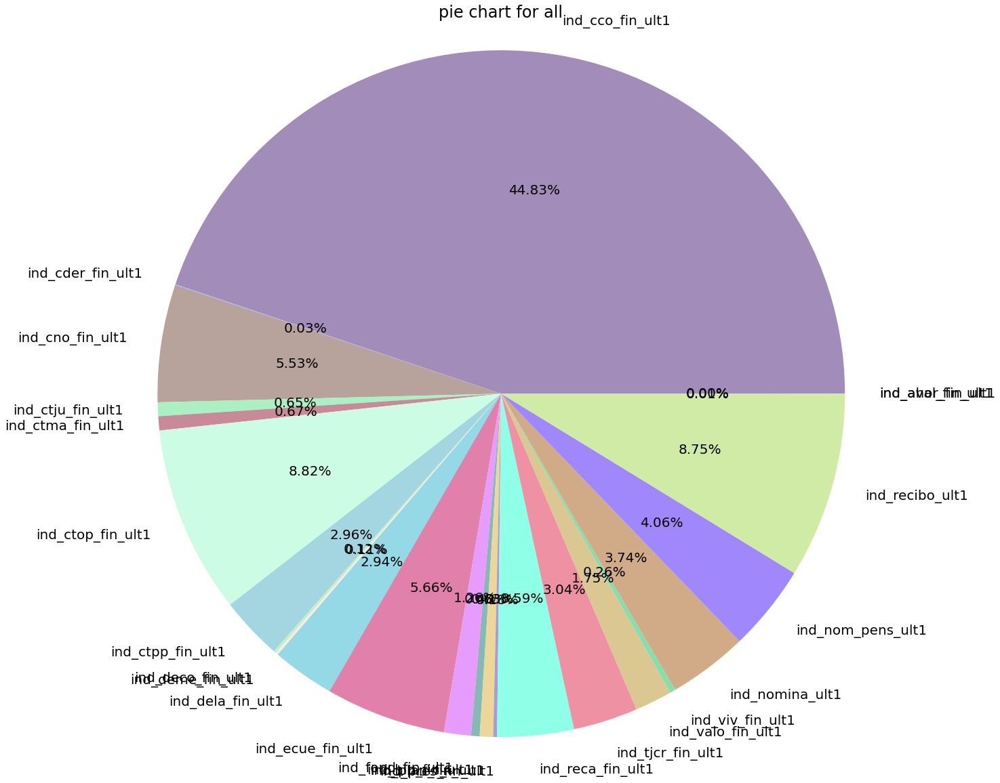

In [177]:
df_sum = df.iloc[:,24:].sum()
plt.figure(figsize = (20, 20))
plt.pie(df_sum, labels = df_sum.index, autopct = '%1.2f%%', colors = colors, textprops={'fontsize': 20})
plt.axis('equal')
plt.title("pie chart for all", fontsize=24)
plt.savefig("pie_chart_all" + ".jpg")

### pie chart for different month

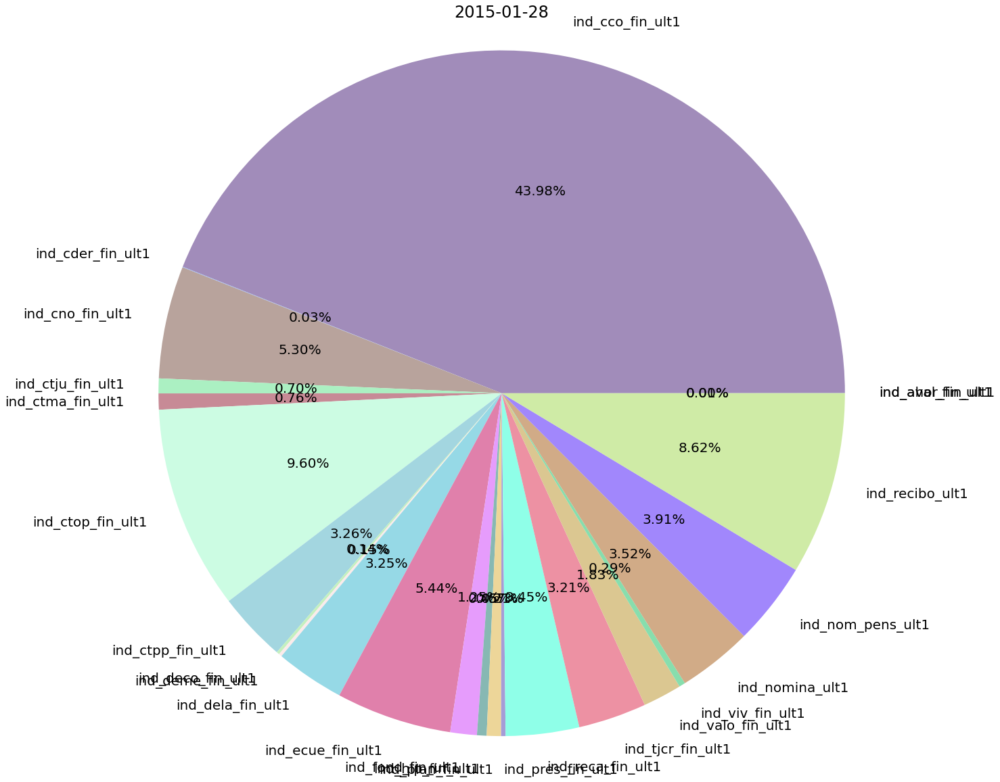

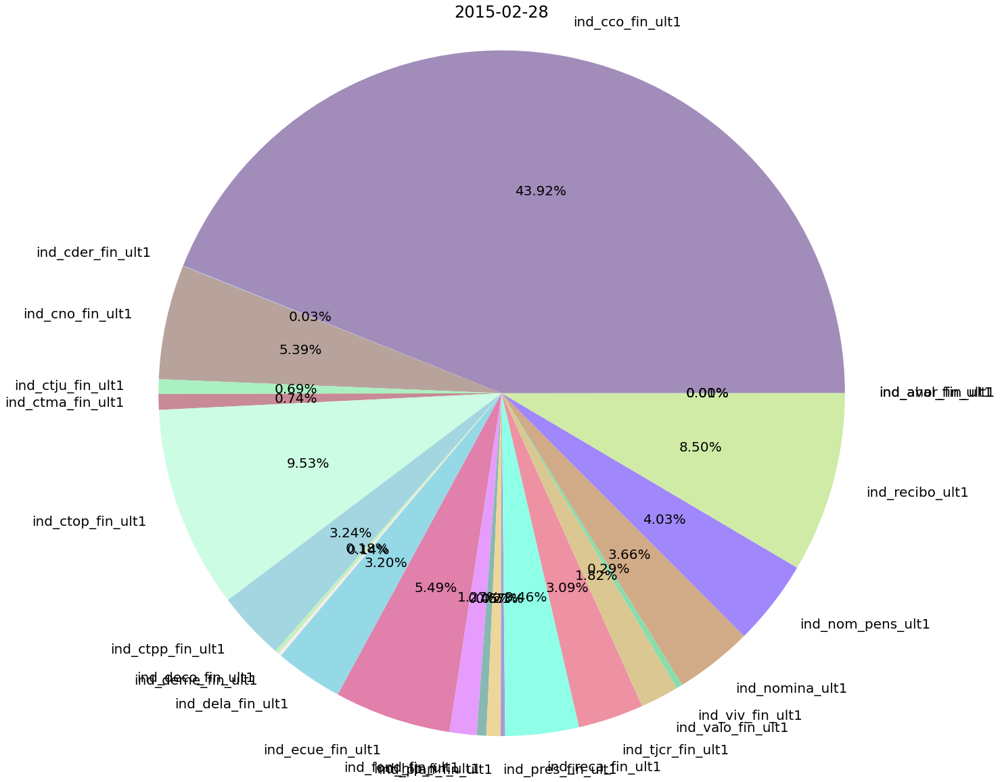

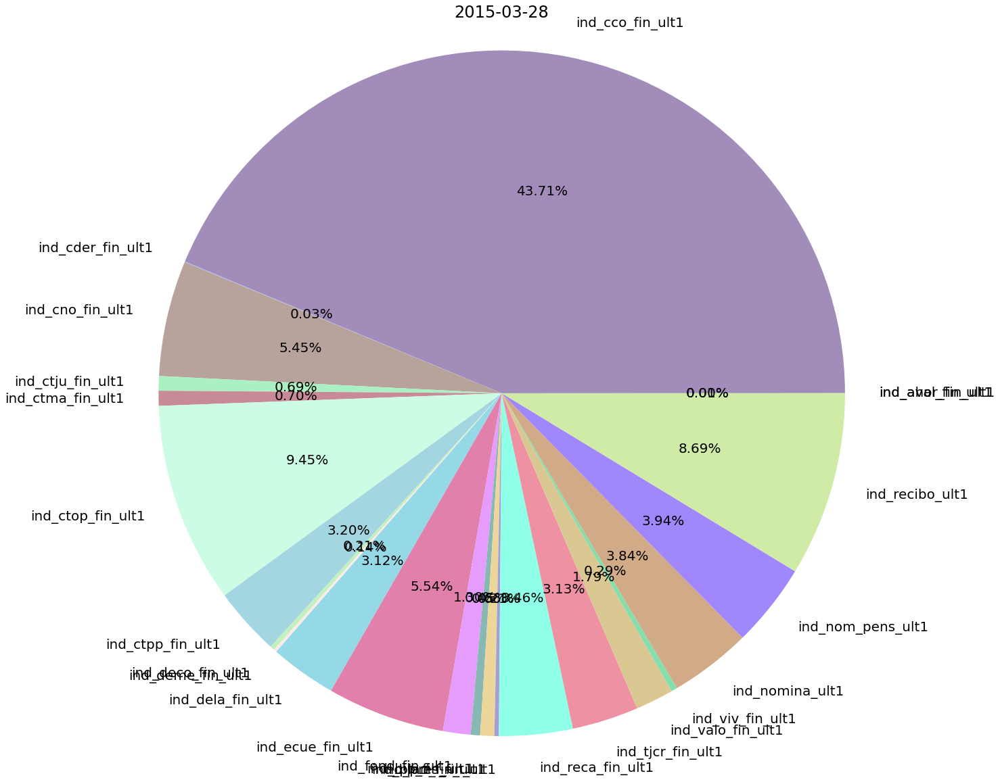

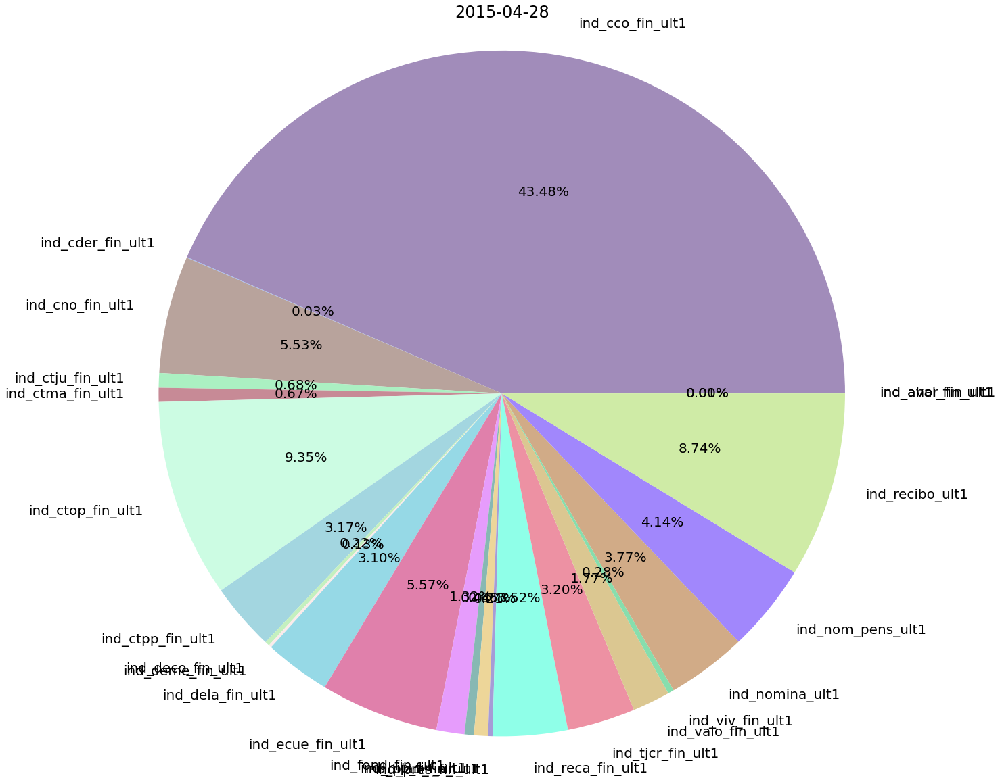

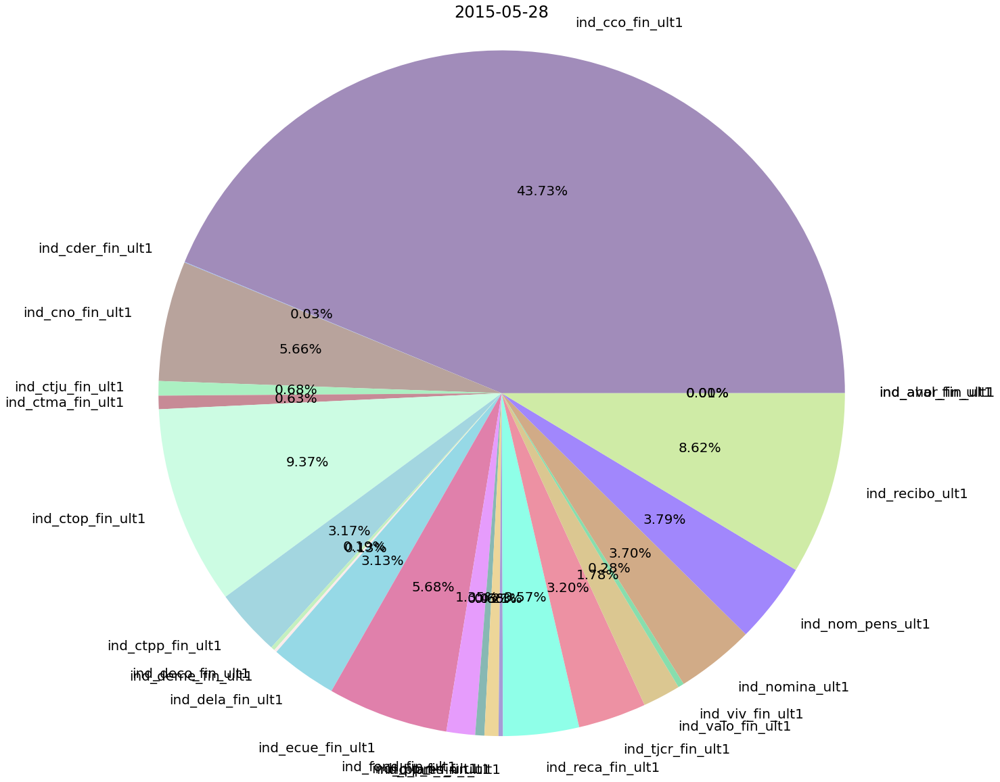

...

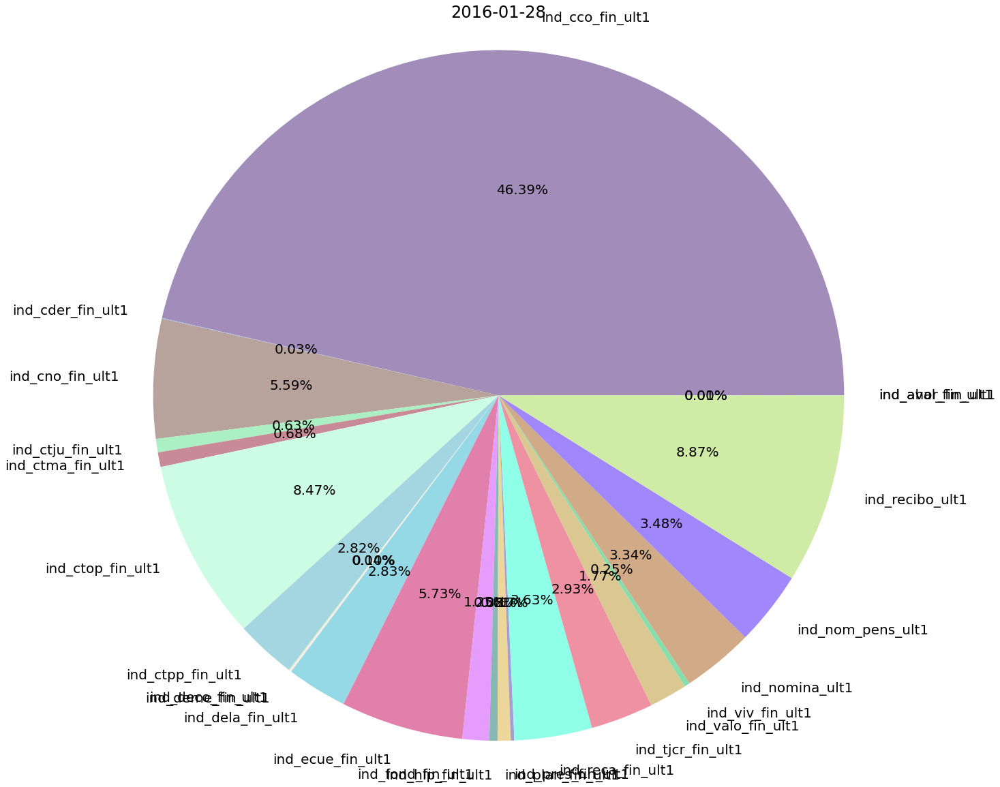

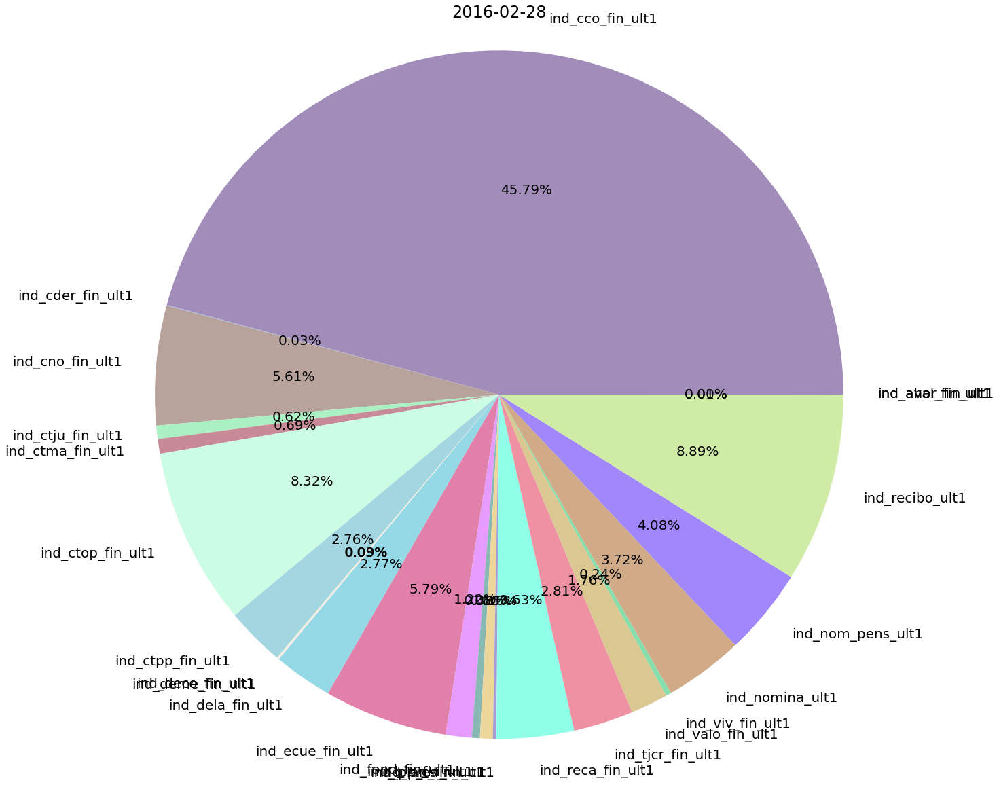

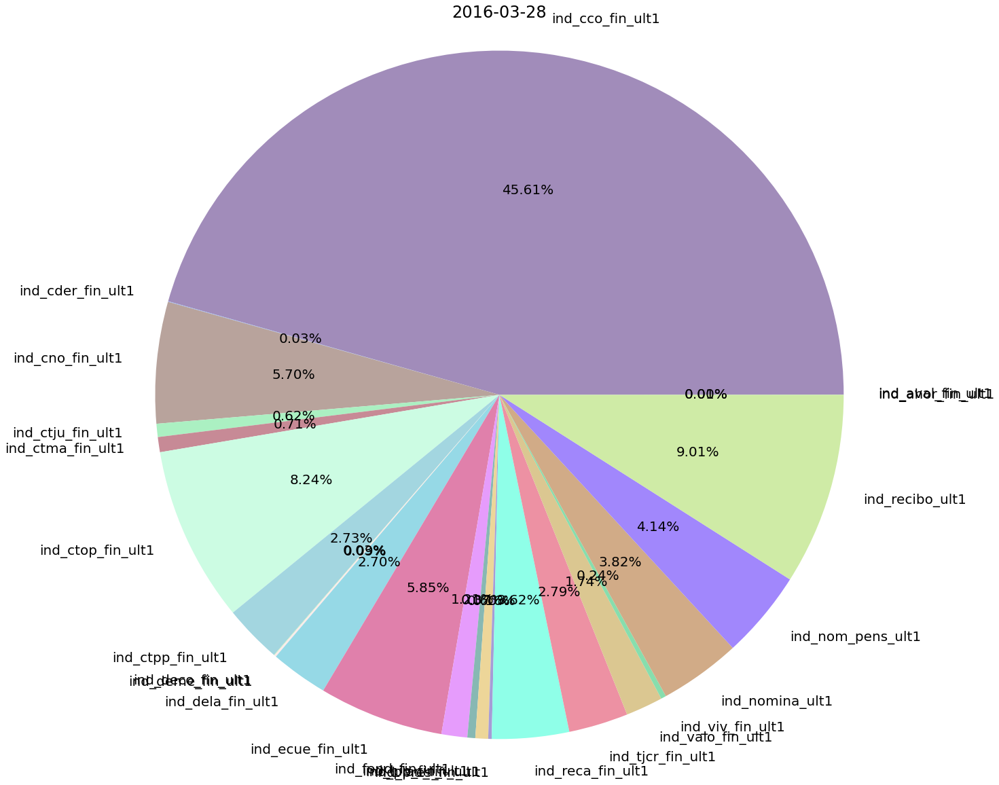

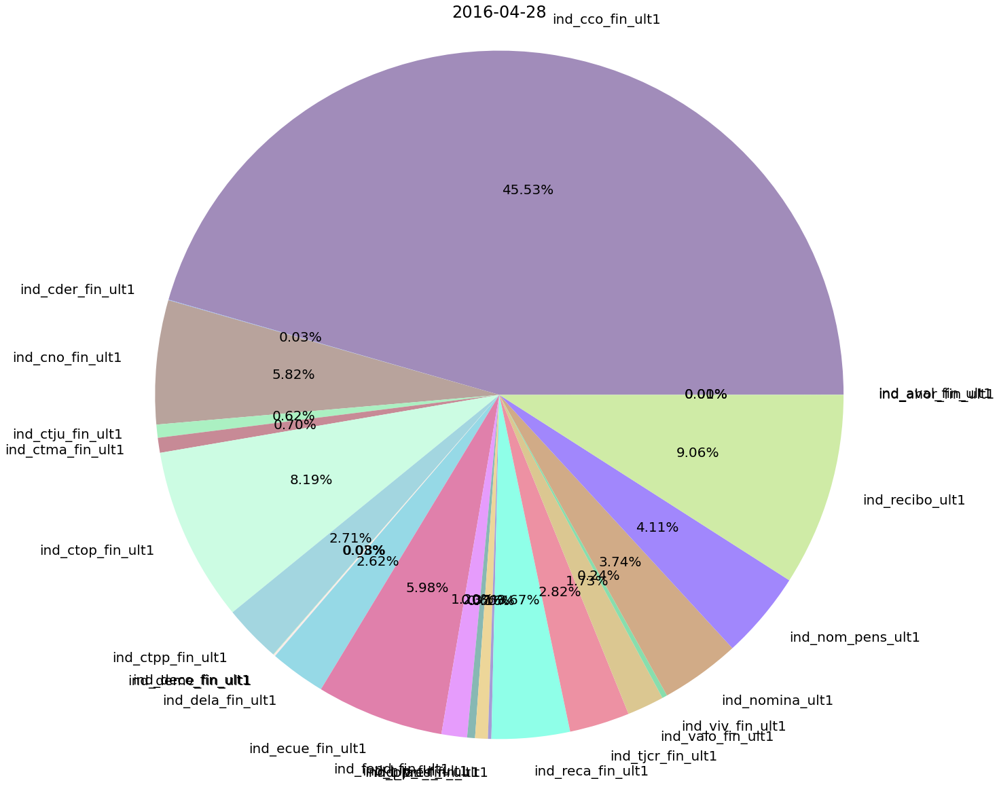

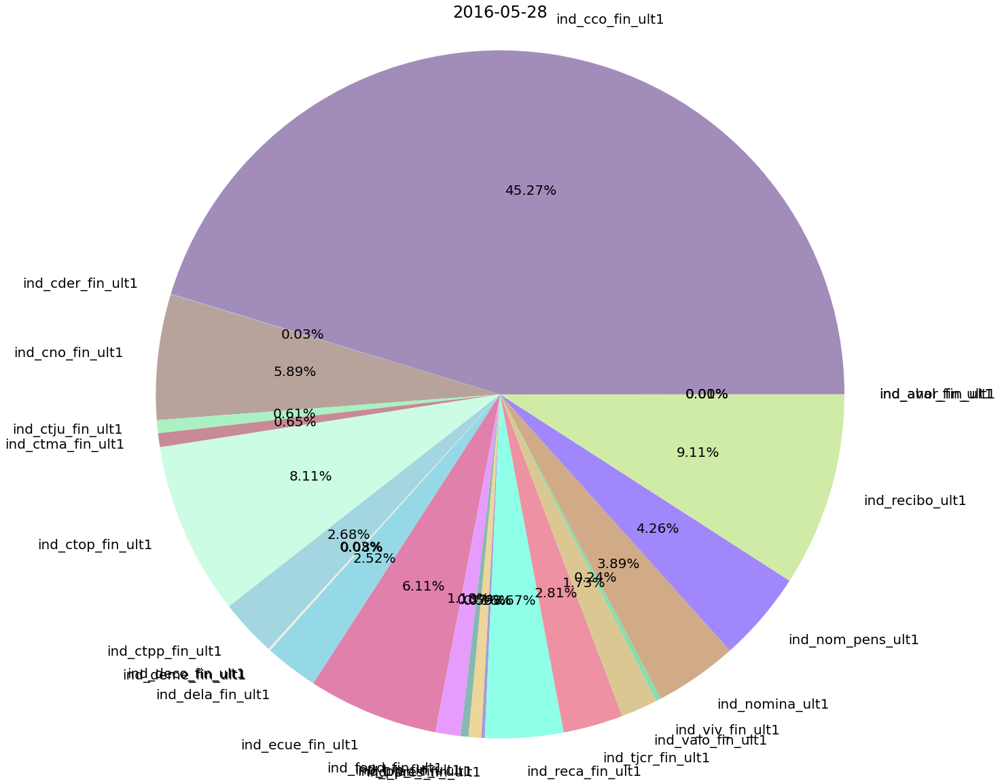

In [119]:
for month in df.loc[:, 'fecha_dato'].unique():
    df_sum = df[df.loc[:, 'fecha_dato'] == month].iloc[:,24:].sum()
    plt.figure(figsize = (20, 20))
    plt.pie(df_sum, labels = df_sum.index, autopct = '%1.2f%%', colors = colors, textprops={'fontsize': 20})
    plt.axis('equal')
    plt.title(month, fontsize=24)
    plt.savefig("pie_chart_" + month + ".jpg")

### pie chart for different gender

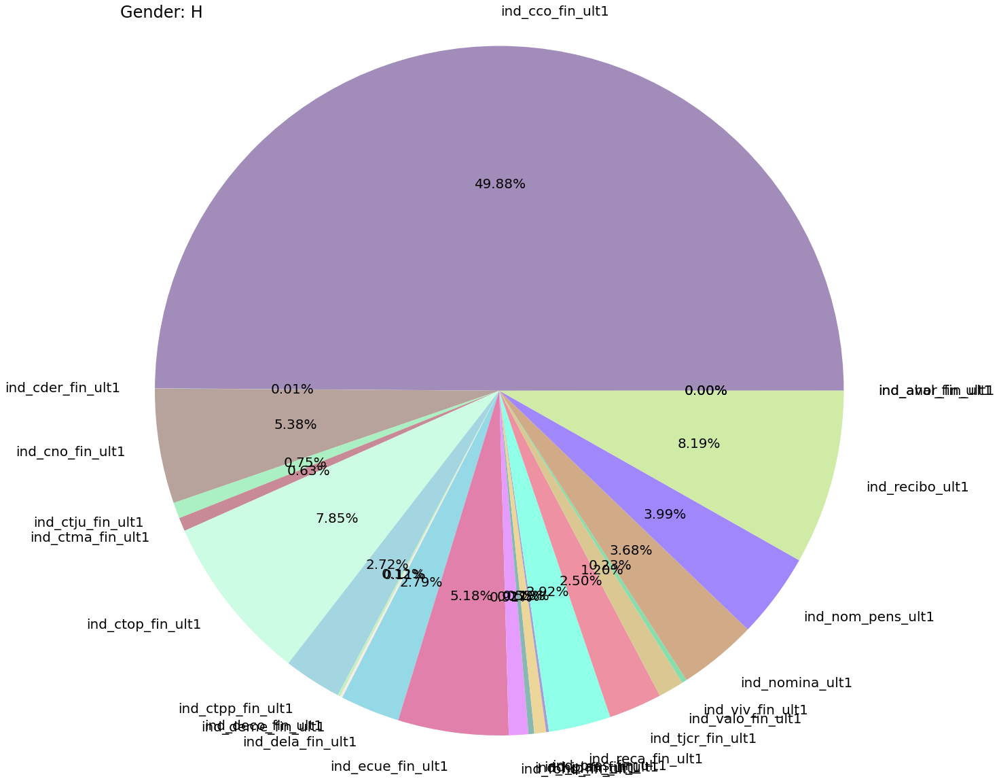

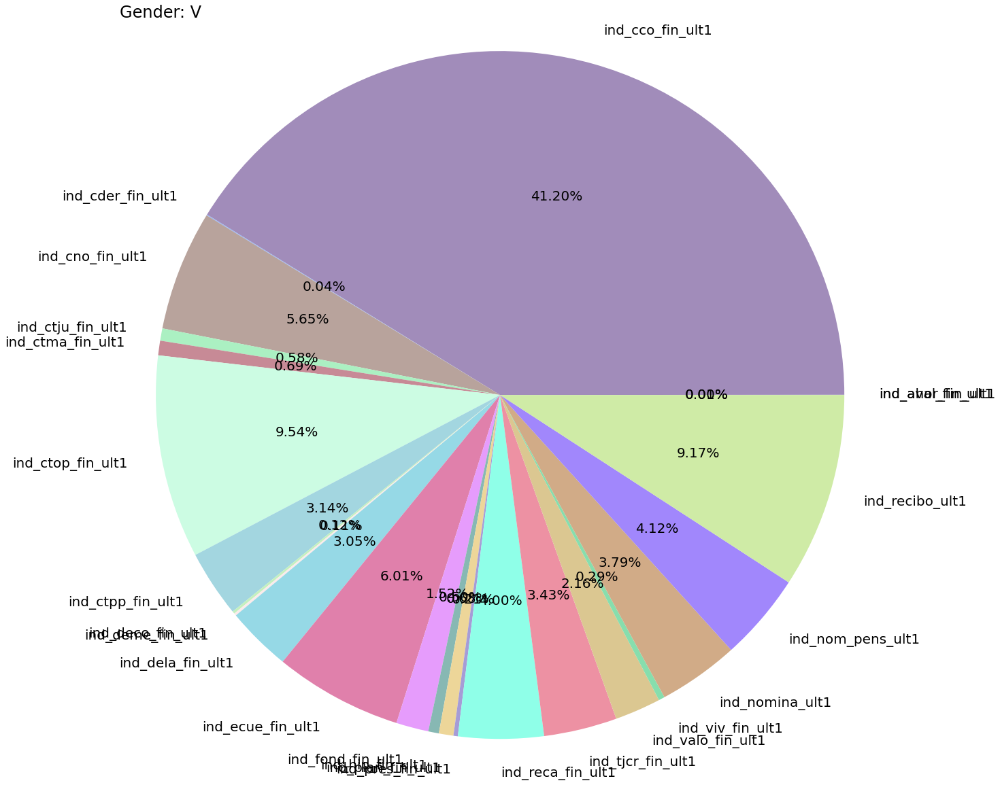

In [138]:
for s in ['H', 'V']:
    df_sum = df[df.loc[:, 'sexo'] == s].iloc[:,24:].sum()
    plt.figure(figsize = (20, 20))
    plt.pie(df_sum, labels = df_sum.index, autopct = '%1.2f%%', colors = colors, textprops={'fontsize': 20})
    plt.axis('equal')
    plt.title("Gender: " + s, fontsize=24, loc = 'left')
    plt.savefig("pie_chart_sexo" + s + ".jpg")

### pie chart for different empleado

There is a Nan...


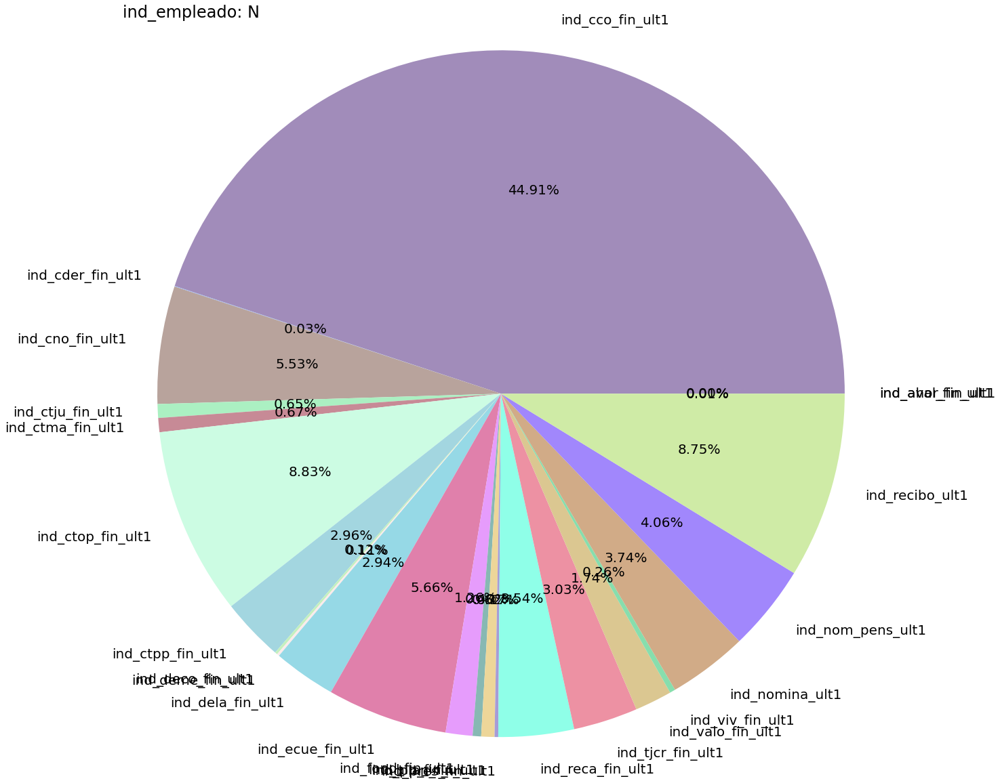

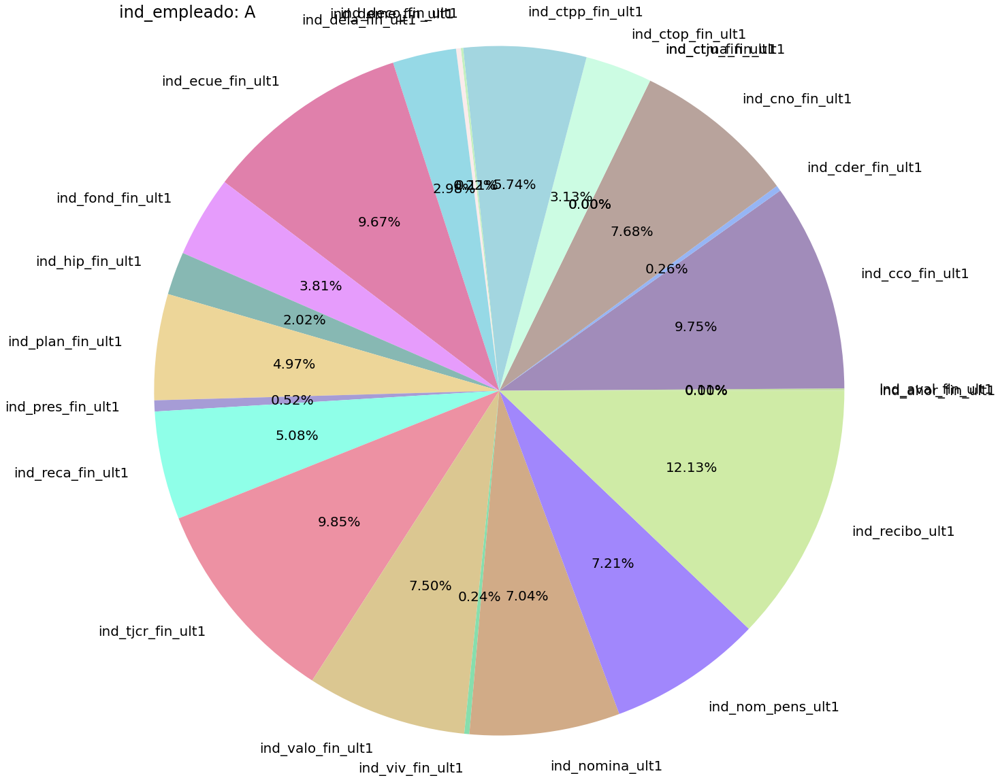

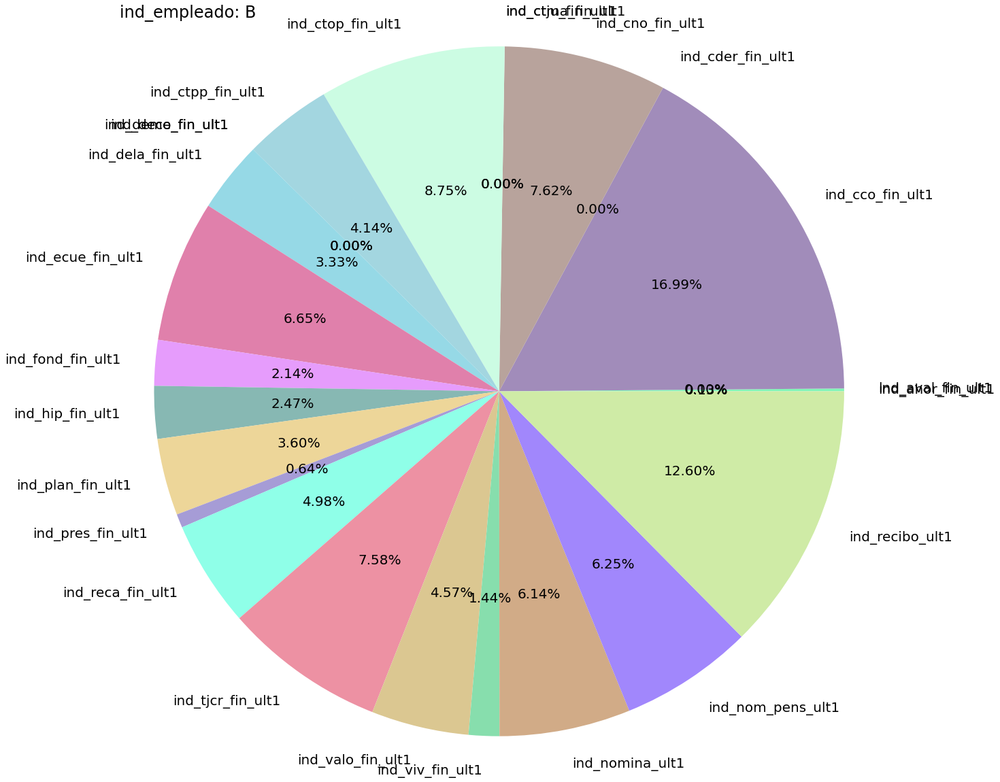

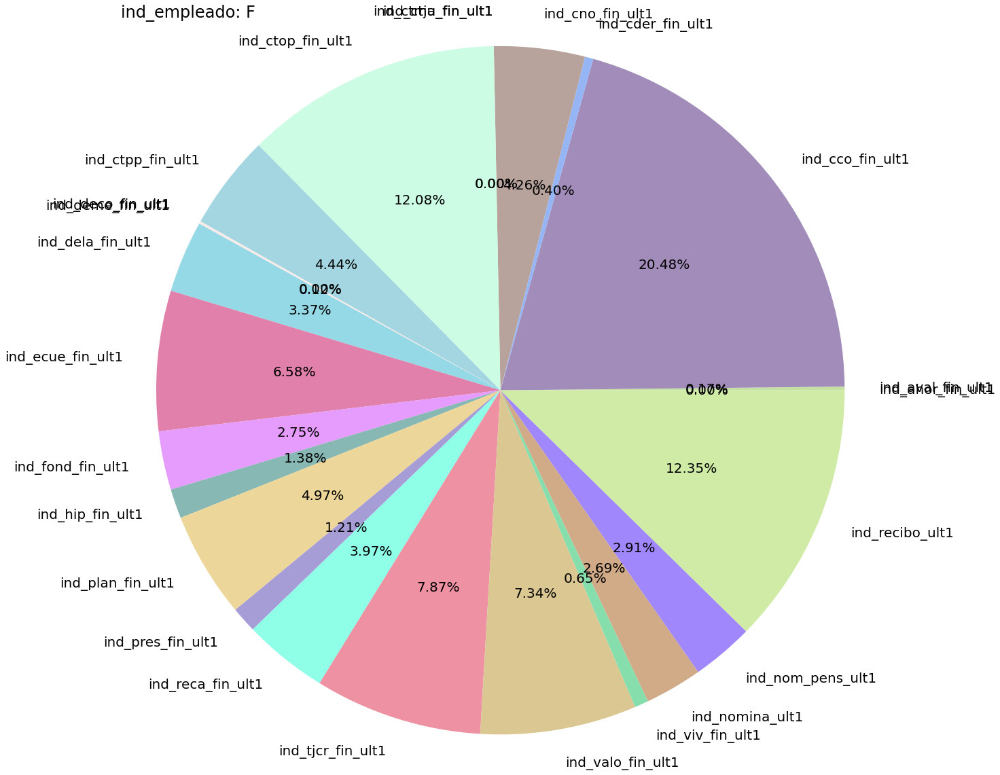

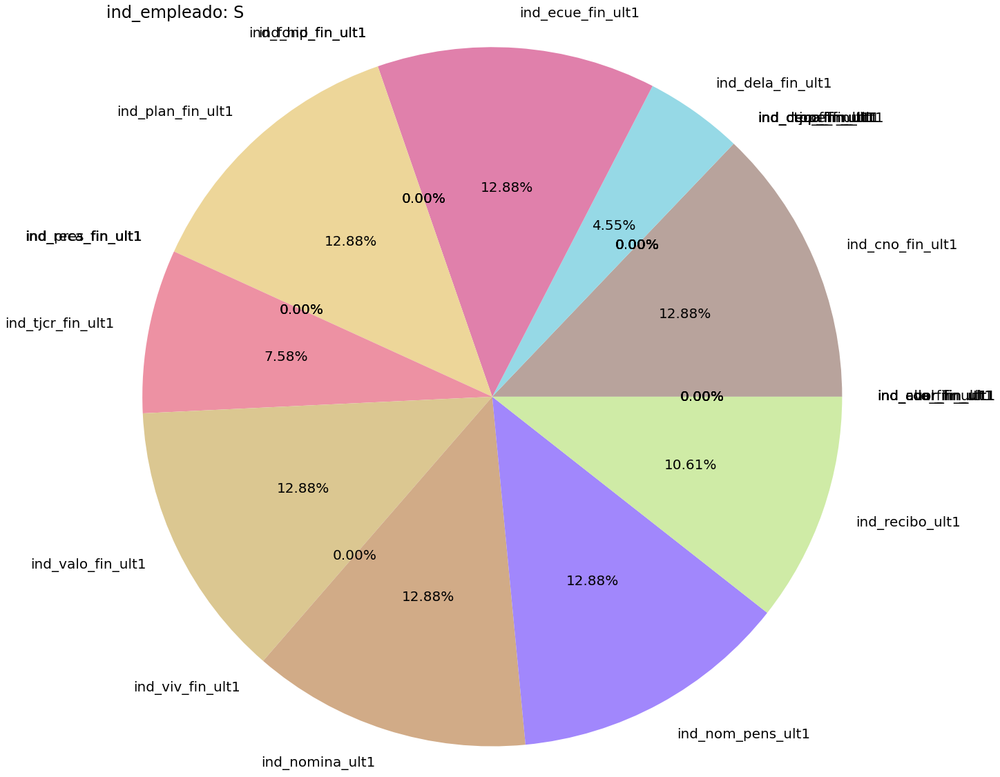

In [144]:
for emp in df.loc[:, 'ind_empleado'].unique():
    if pd.isna(emp):
        print("There is a Nan...")
        continue
    df_sum = df[df.loc[:, 'ind_empleado'] == emp].iloc[:,24:].sum()
    plt.figure(figsize = (20, 20))
    plt.pie(df_sum, labels = df_sum.index, autopct = '%1.2f%%', colors = colors, textprops={'fontsize': 20})
    plt.axis('equal')
    plt.title("ind_empleado: " + emp, fontsize=24, loc = 'left')
    plt.savefig("pie_chart_ind_empleado_" + emp + ".jpg")

### pie chart for different segmento

There is a Nan...


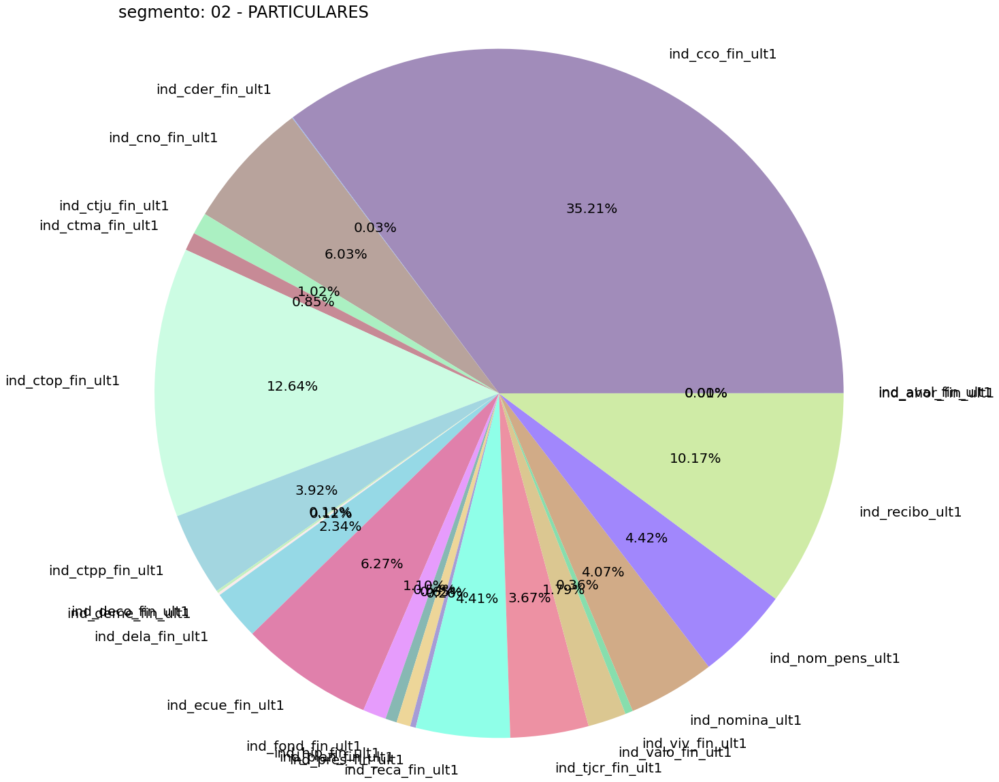

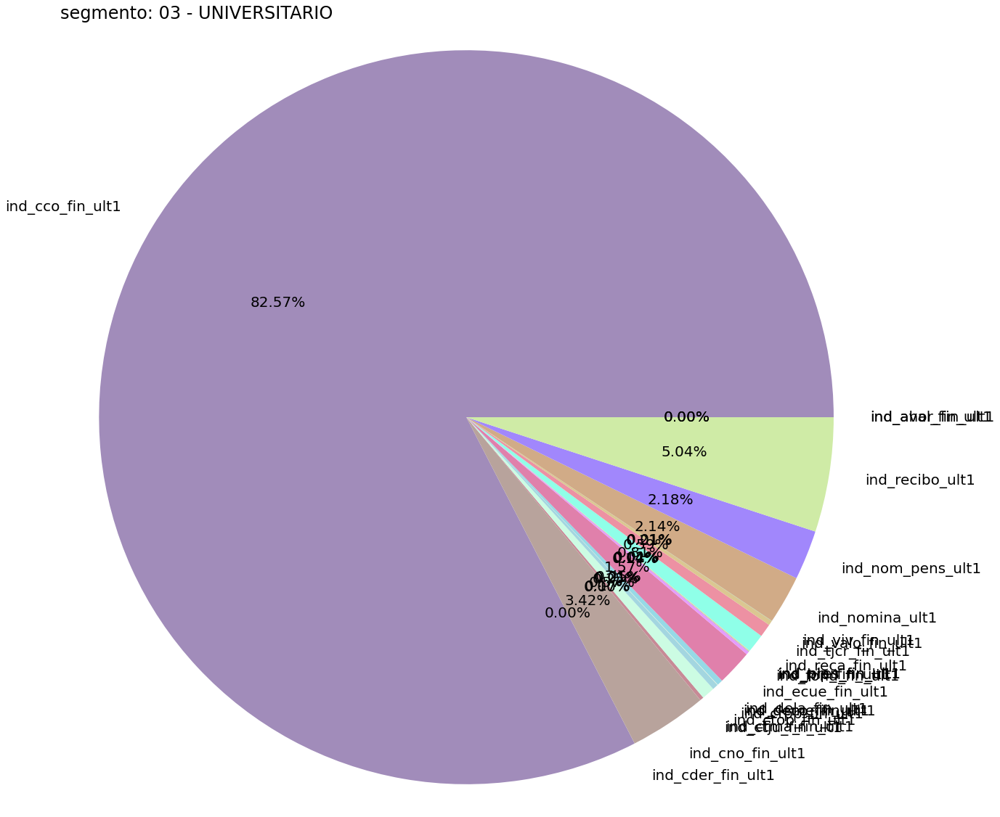

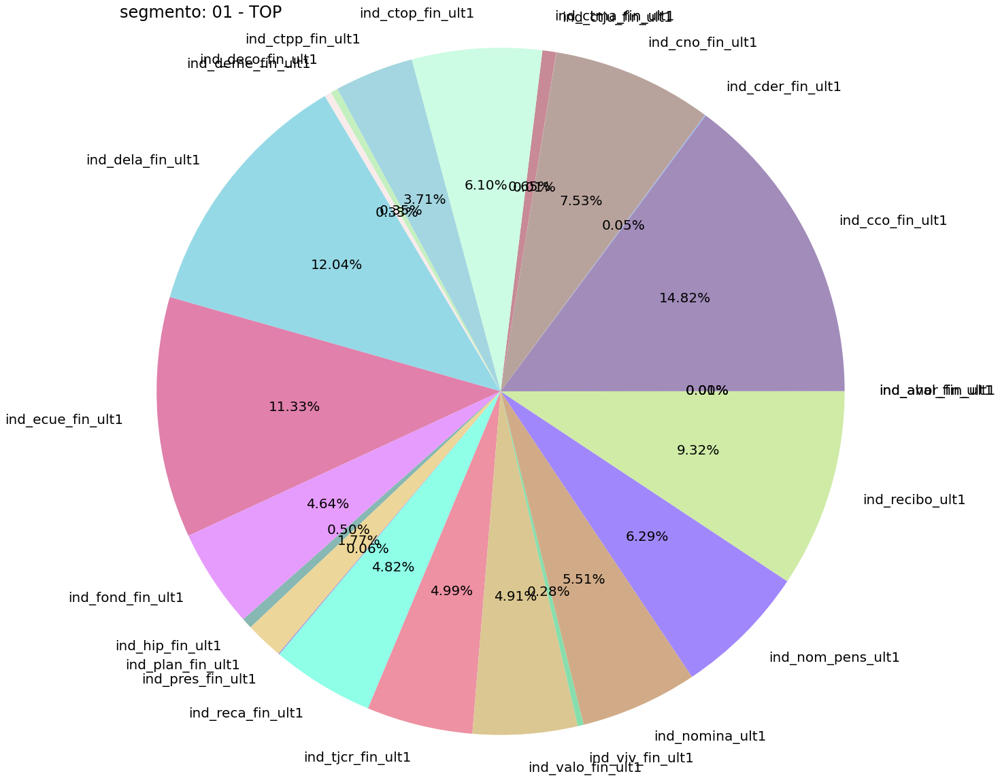

In [148]:
for seg in df.loc[:, 'segmento'].unique():
    if pd.isna(seg):
        print("There is a Nan...")
        continue
    df_sum = df[df.loc[:, 'segmento'] == seg].iloc[:,24:].sum()
    plt.figure(figsize = (20, 20))
    plt.pie(df_sum, labels = df_sum.index, autopct = '%1.2f%%', colors = colors, textprops={'fontsize': 20})
    plt.axis('equal')
    plt.title("segmento: " + seg, fontsize=24, loc = 'left')
    plt.savefig("pie_chart_segmento_" + seg + ".jpg")

### pie chart for pais_residencia

AL, MZ, TW, NI, GT, BA, MD, PK, SL, GN, GW, LV, ML, MK, IS, LY, CF, KZ, CD, BZ

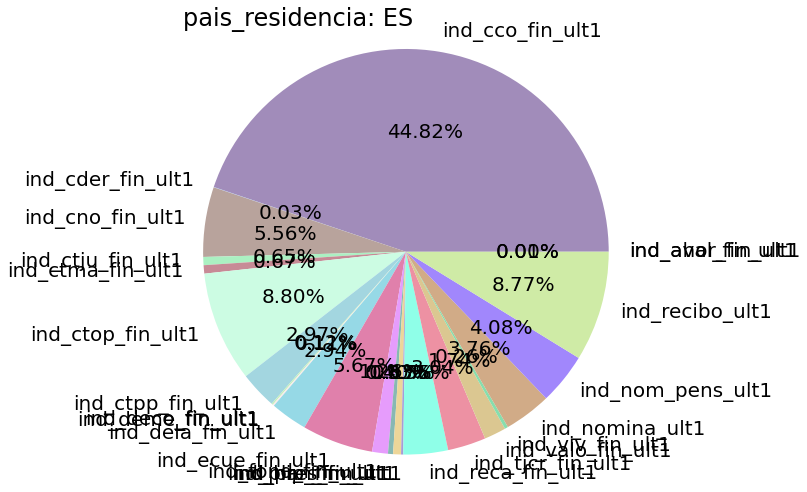

There is a Nan...


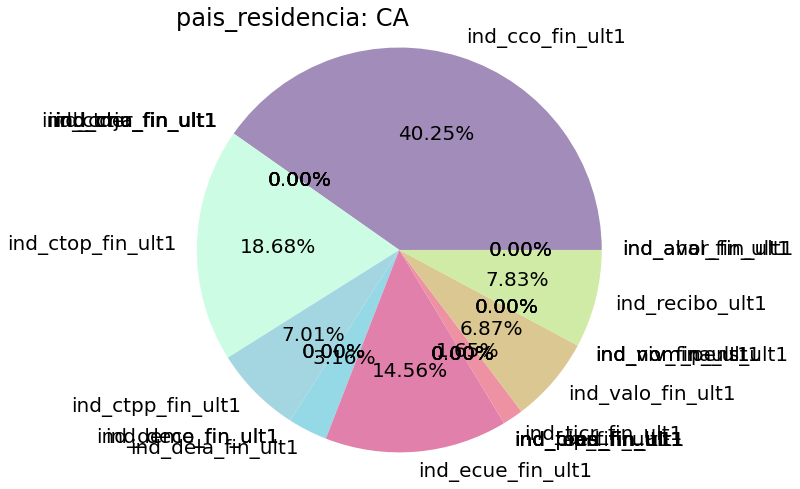

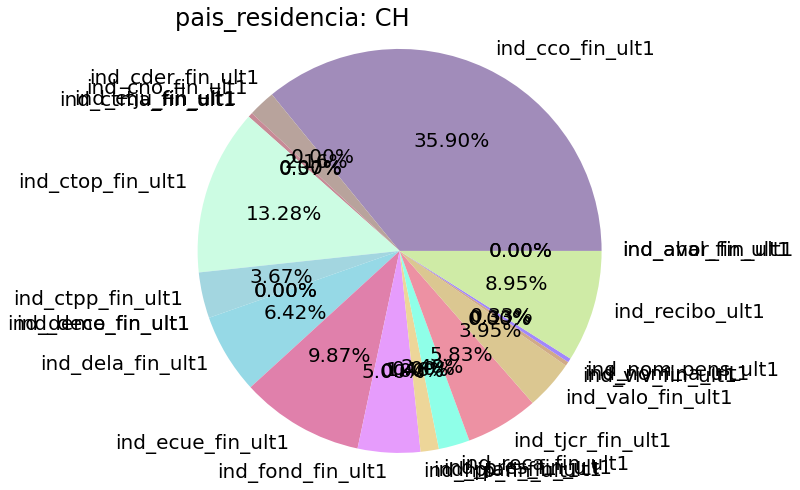

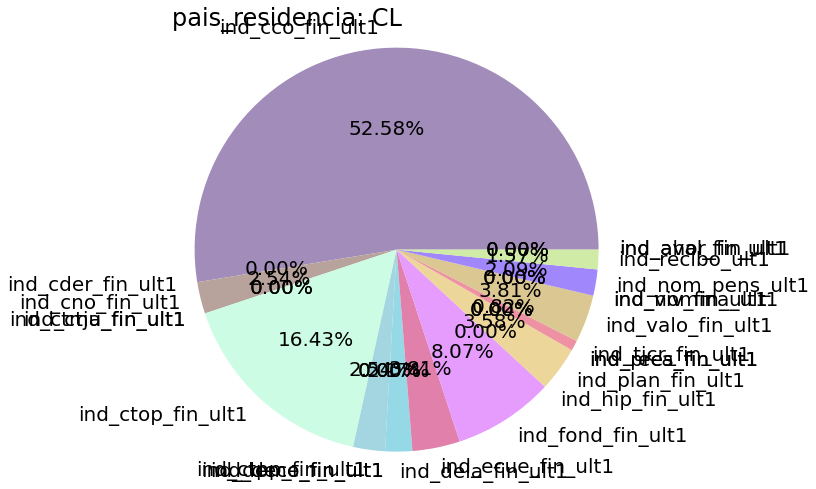

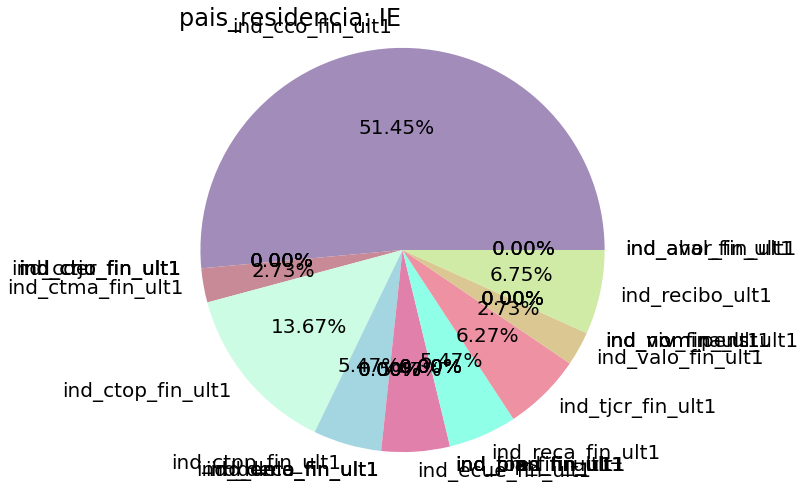

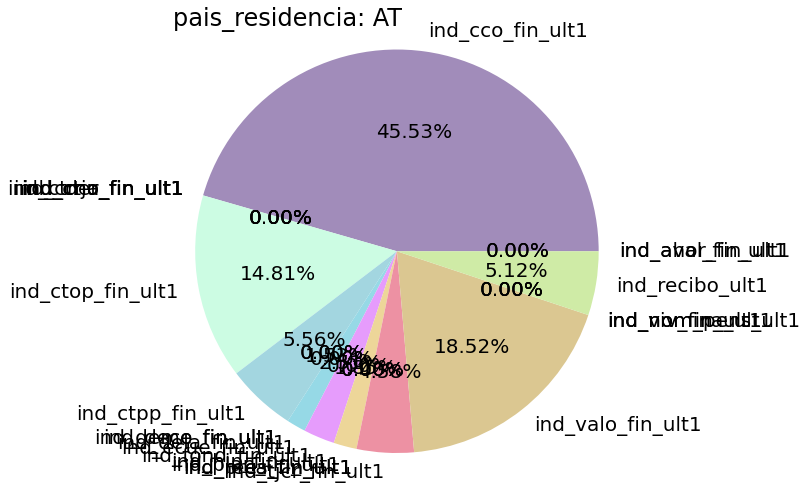

...

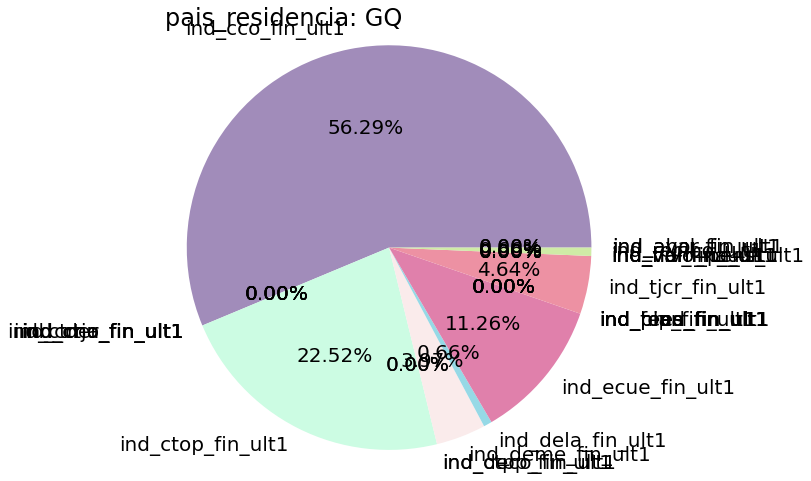

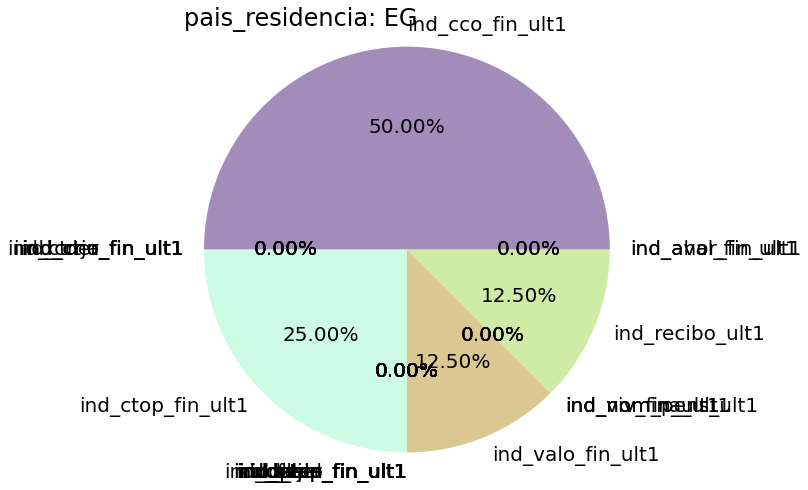

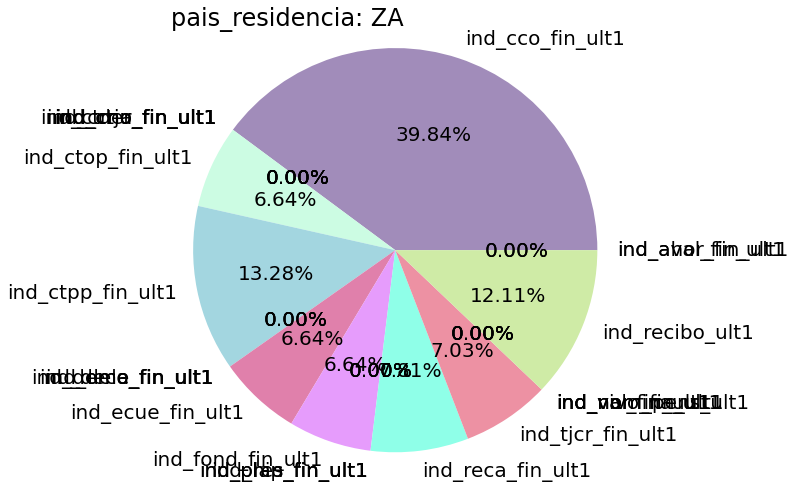

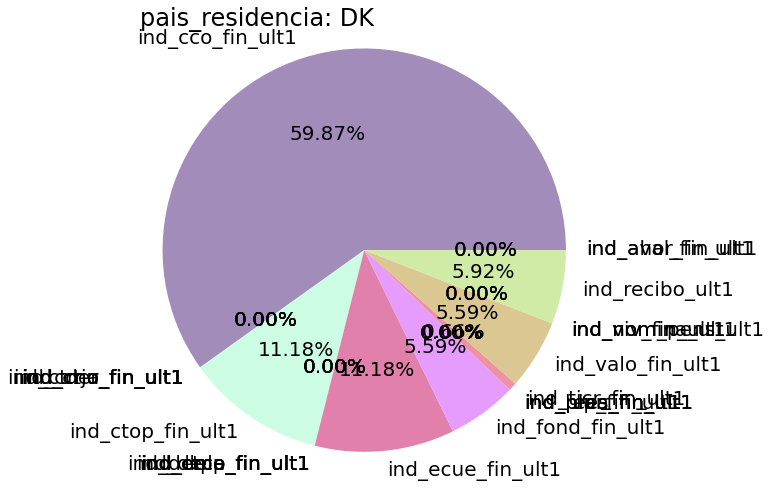

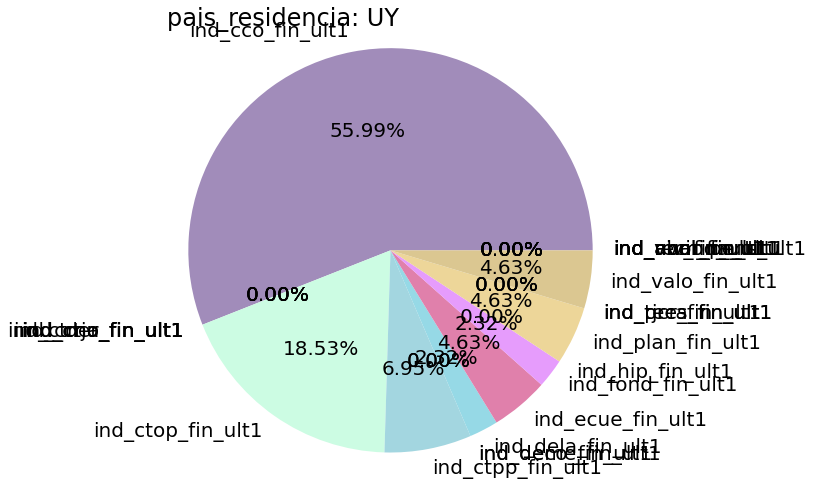

/Users/yangyating/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: MatplotlibDeprecationWarning: normalize=None does not normalize if the sum is less than 1 but this behavior is deprecated since 3.3 until two minor releases later. After the deprecation period the default value will be normalize=True. To prevent normalization pass normalize=False 
  import sys


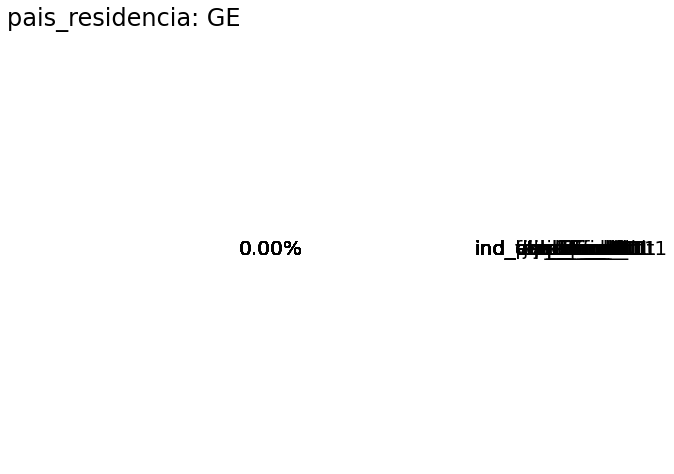

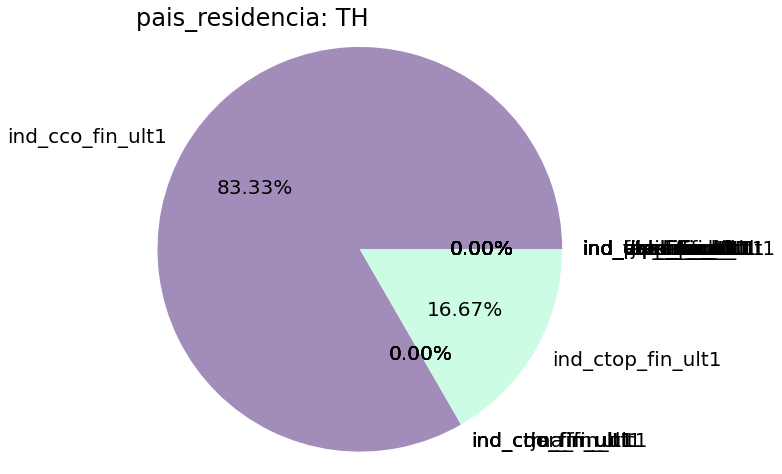

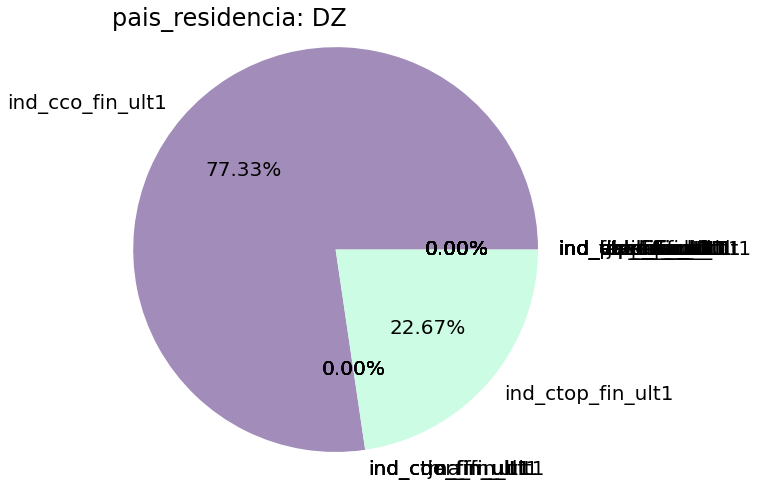

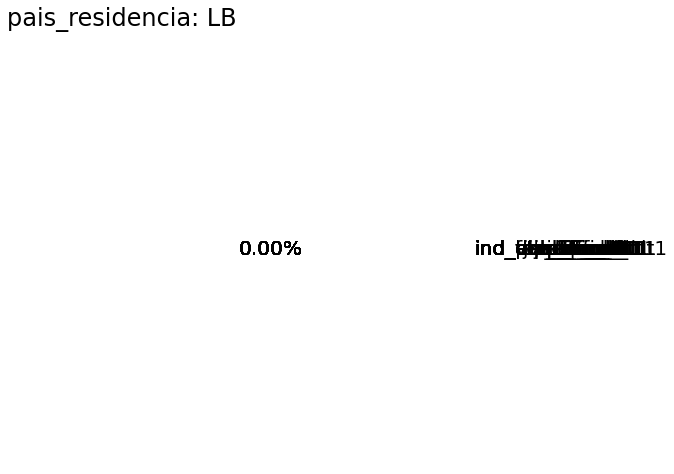

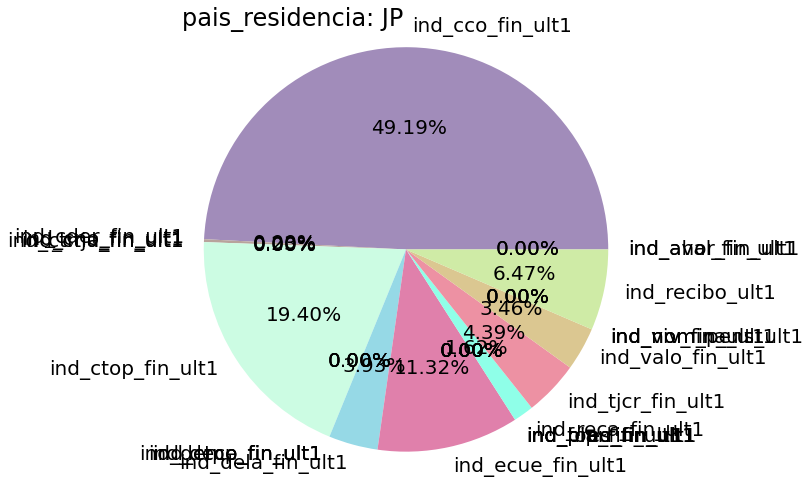

...

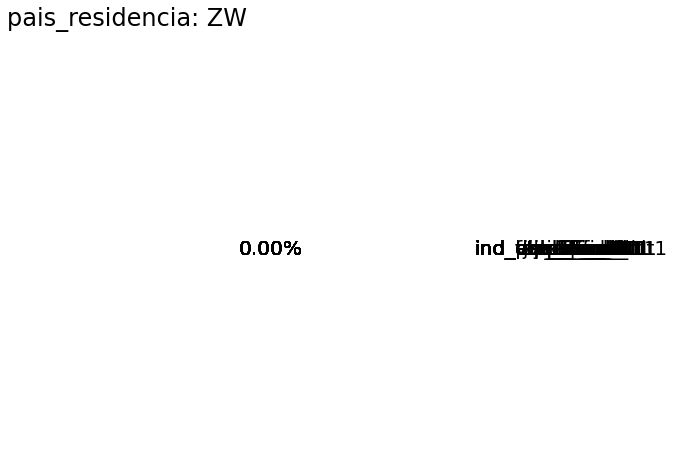

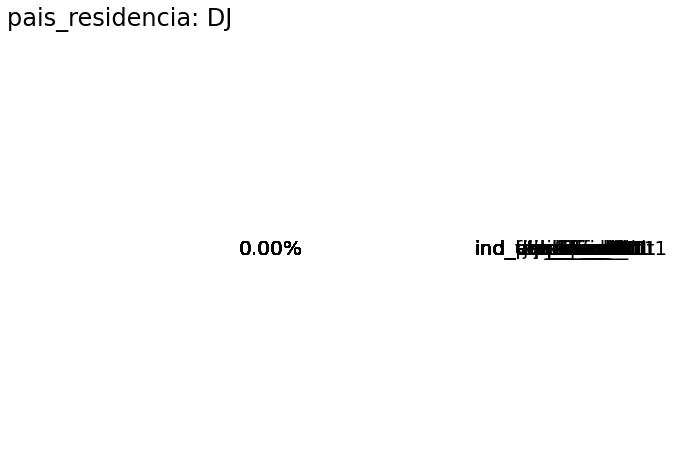

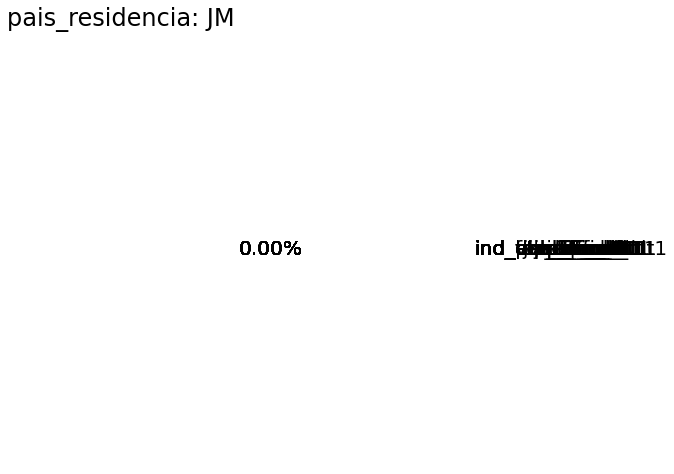

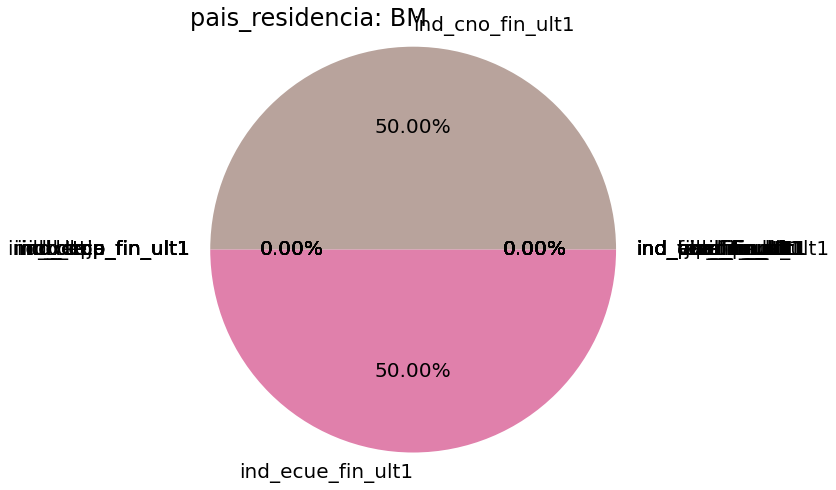

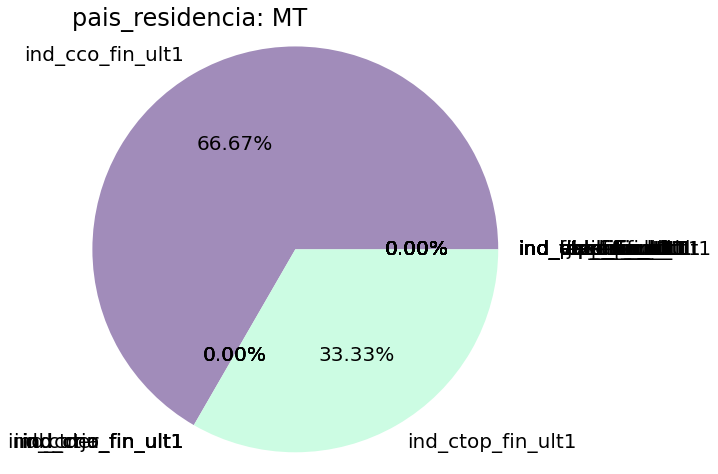

In [155]:
for res in df.loc[:, 'pais_residencia'].unique():
    if pd.isna(res):
        print("There is a Nan...")
        continue
    df_sum = df[df.loc[:, 'pais_residencia'] == res].iloc[:,24:].sum()
    plt.figure(figsize = (8, 8))
    plt.pie(df_sum, labels = df_sum.index, autopct = '%1.2f%%', colors = colors, textprops={'fontsize': 20})
    plt.axis('equal')
    plt.title("pais_residencia: " + res, fontsize=24, loc = 'left')
    plt.show()
    #plt.savefig("pie_chart_pais_residencia_" + seg + ".jpg")

In [197]:
print(df.loc[:, 'segmento'].unique())
df[df.loc[:, 'segmento'] == "03 - UNIVERSITARIO"]

['02 - PARTICULARES' '03 - UNIVERSITARIO' nan '01 - TOP']


,fecha_dato,ncodpers,ind_empleado,pais_residencia,sexo,age,fecha_alta,ind_nuevo,antiguedad,indrel,...,ind_hip_fin_ult1,ind_plan_fin_ult1,ind_pres_fin_ult1,ind_reca_fin_ult1,ind_tjcr_fin_ult1,ind_valo_fin_ult1,ind_viv_fin_ult1,ind_nomina_ult1,ind_nom_pens_ult1,ind_recibo_ult1
1,2015-01-28,1050611,N,ES,V,23,2012-08-10,0.0,35,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
2,2015-01-28,1050612,N,ES,V,23,2012-08-10,0.0,35,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
3,2015-01-28,1050613,N,ES,H,22,2012-08-10,0.0,35,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
4,2015-01-28,1050614,N,ES,V,23,2012-08-10,0.0,35,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
5,2015-01-28,1050615,N,ES,H,23,2012-08-10,0.0,35,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13647302,2016-05-28,1166767,N,ES,V,25,2013-08-14,0.0,33,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
13647303,2016-05-28,1166766,N,ES,V,25,2013-08-14,0.0,33,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
13647304,2016-05-28,1166765,N,ES,V,22,2013-08-14,0.0,33,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0
13647305,2016-05-28,1166764,N,ES,V,23,2013-08-14,0.0,33,1.0,...,0,0,0,0,0,0,0,0.0,0.0,0


### pie chart for tiprel_1mes

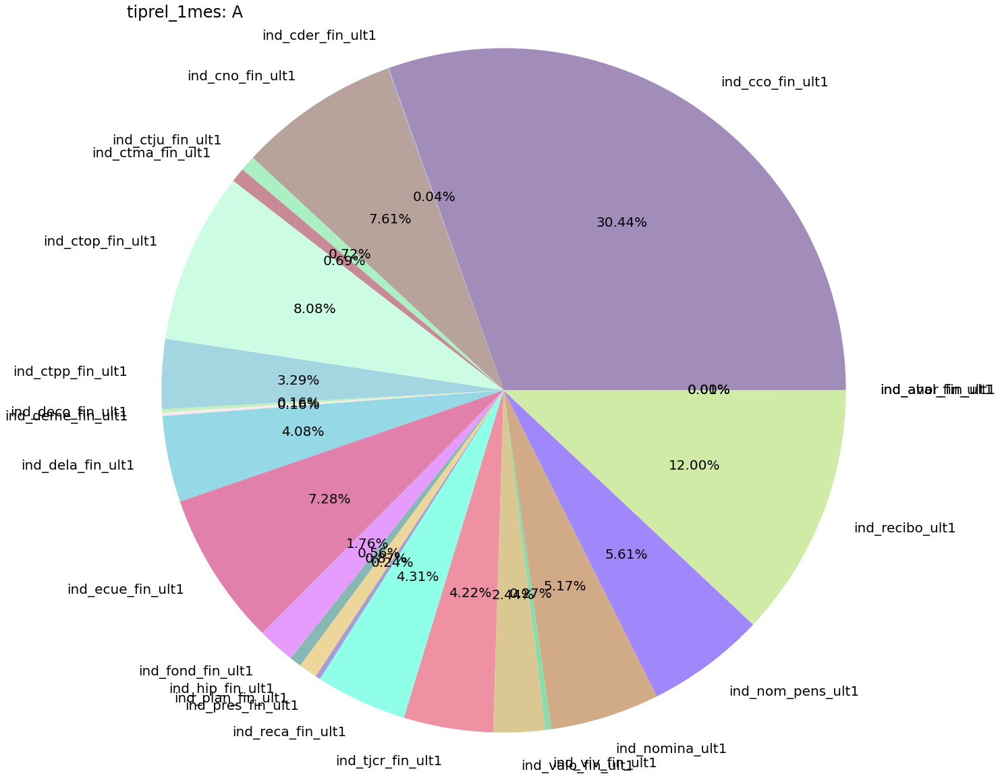

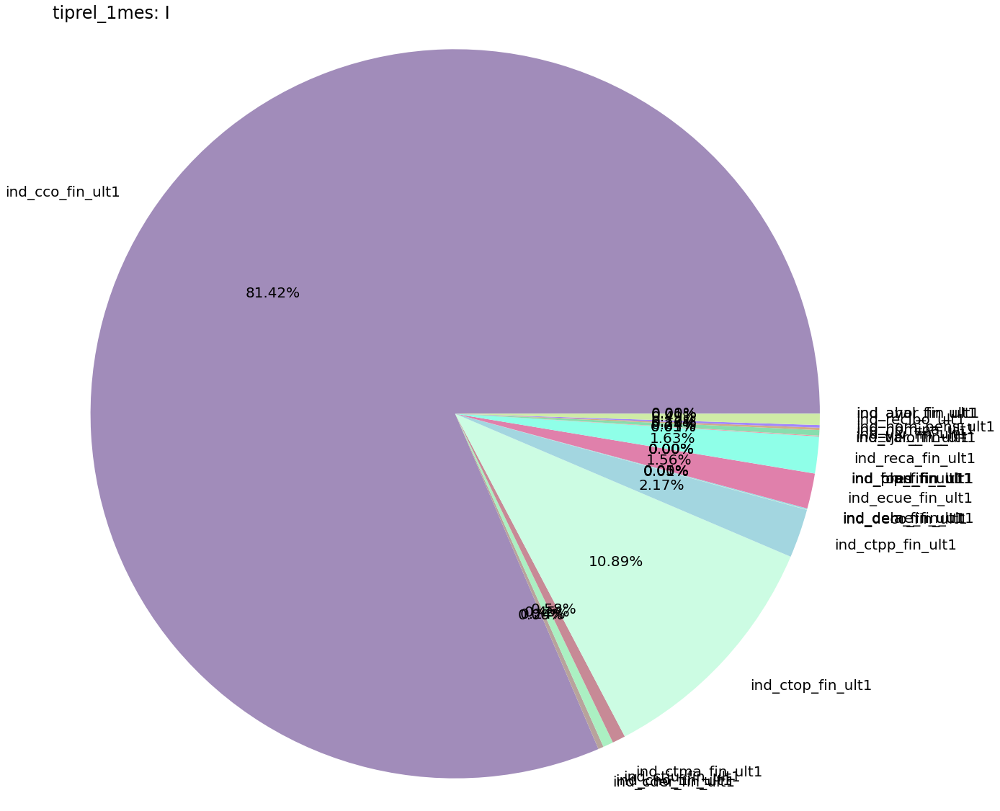

There is a Nan...


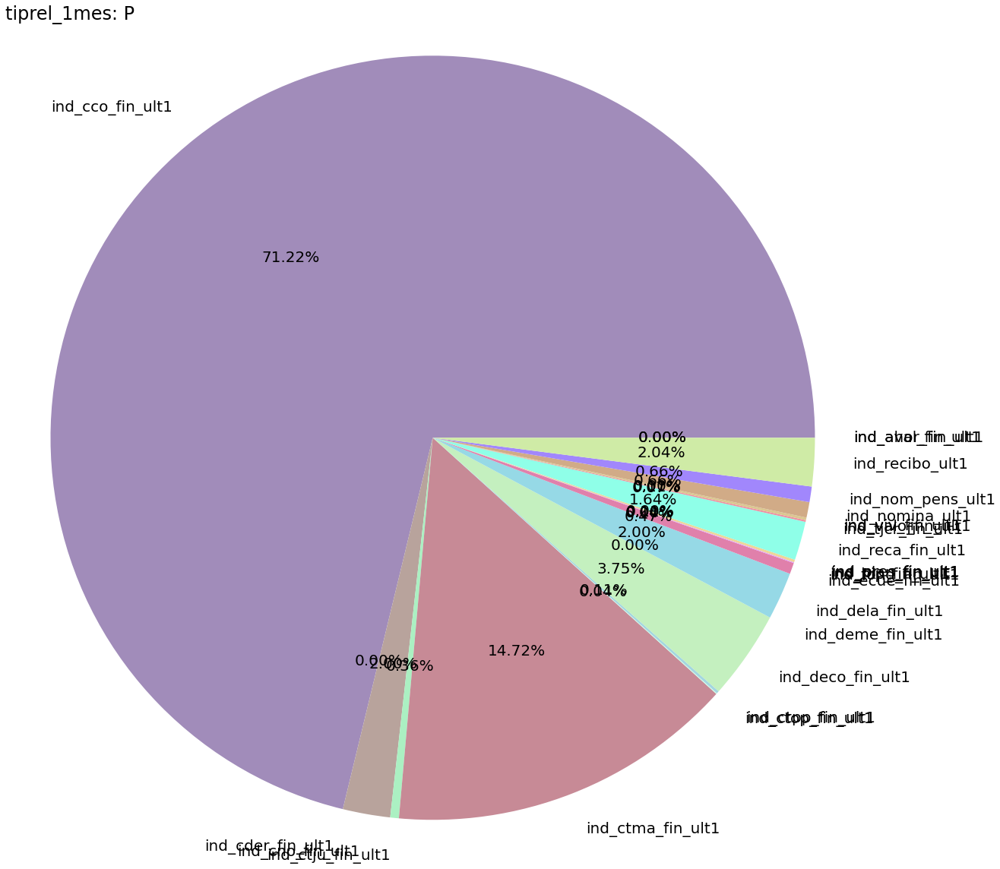

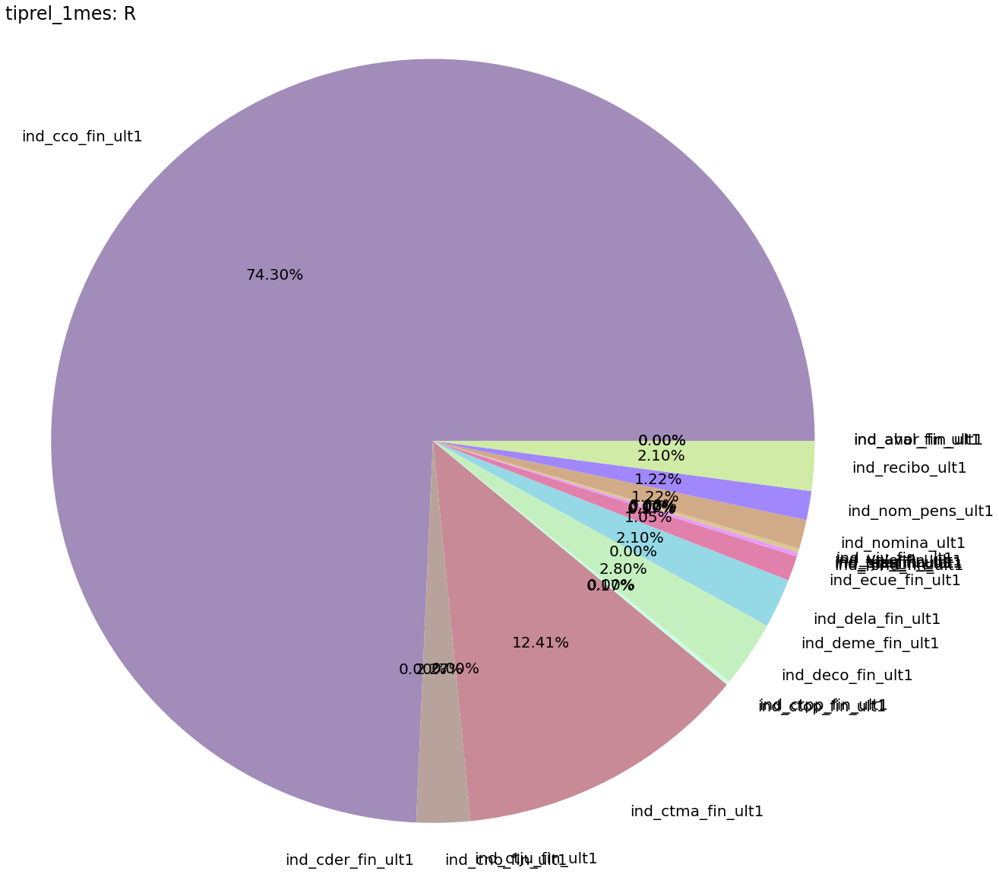

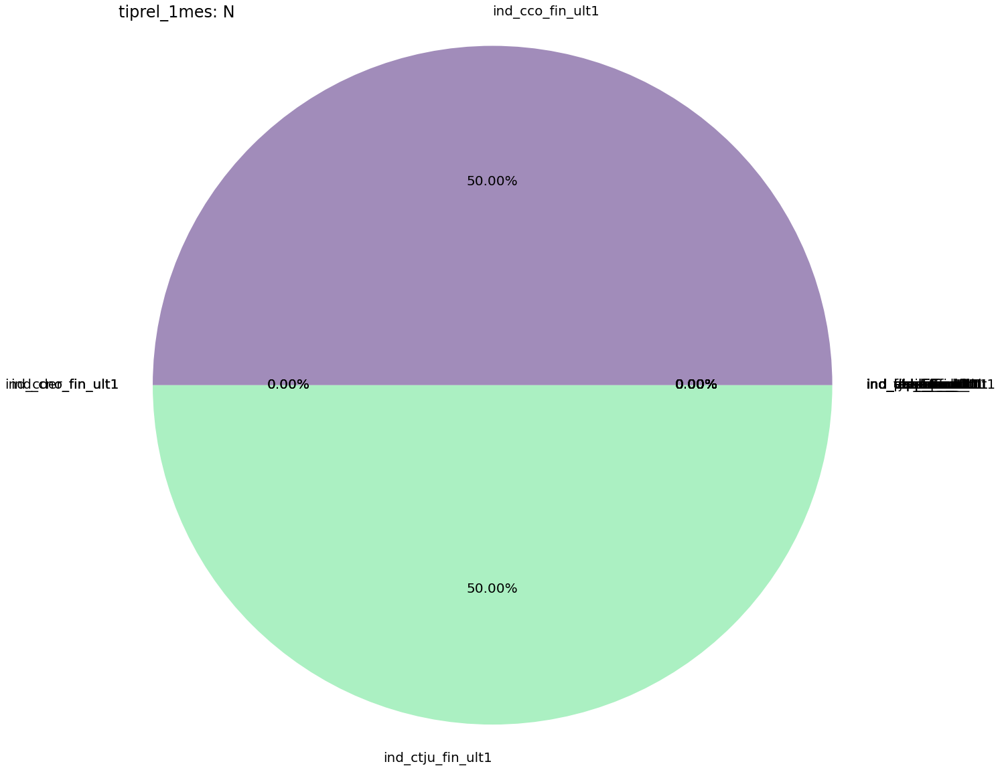

In [154]:
for lme in df.loc[:, 'tiprel_1mes'].unique():
    if pd.isna(lme):
        print("There is a Nan...")
        continue
    df_sum = df[df.loc[:, 'tiprel_1mes'] == lme].iloc[:,24:].sum()
    plt.figure(figsize = (20, 20))
    plt.pie(df_sum, labels = df_sum.index, autopct = '%1.2f%%', colors = colors, textprops={'fontsize': 20})
    plt.axis('equal')
    plt.title("tiprel_1mes: " + lme, fontsize=24, loc = 'left')
    plt.show()
    #plt.savefig("pie_chart_tiprel_1mes_" + seg + ".jpg")

### pie chart for nomprov

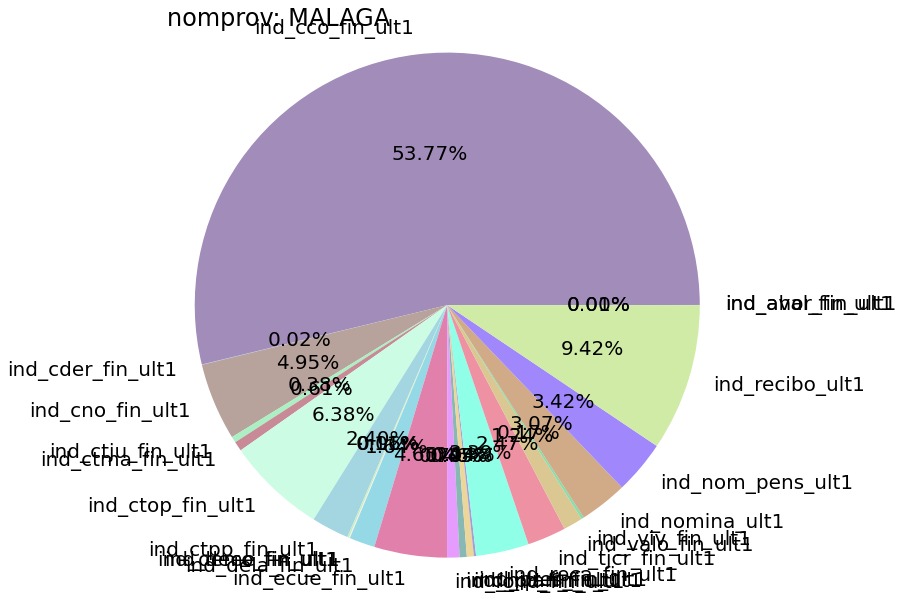

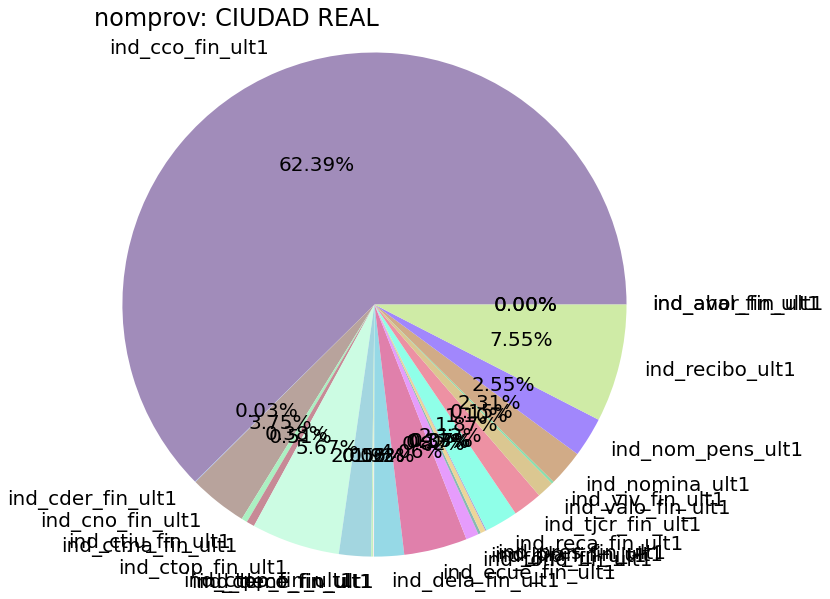

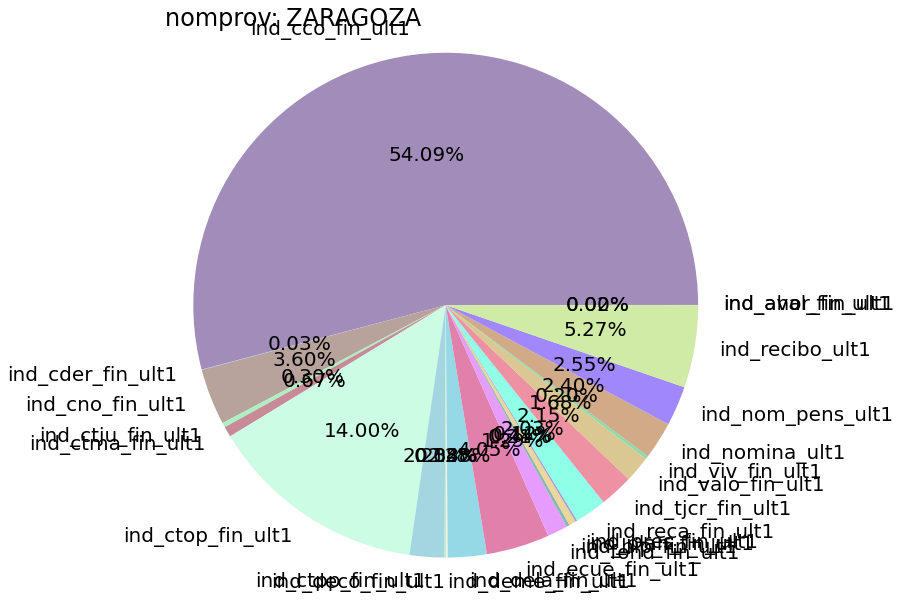

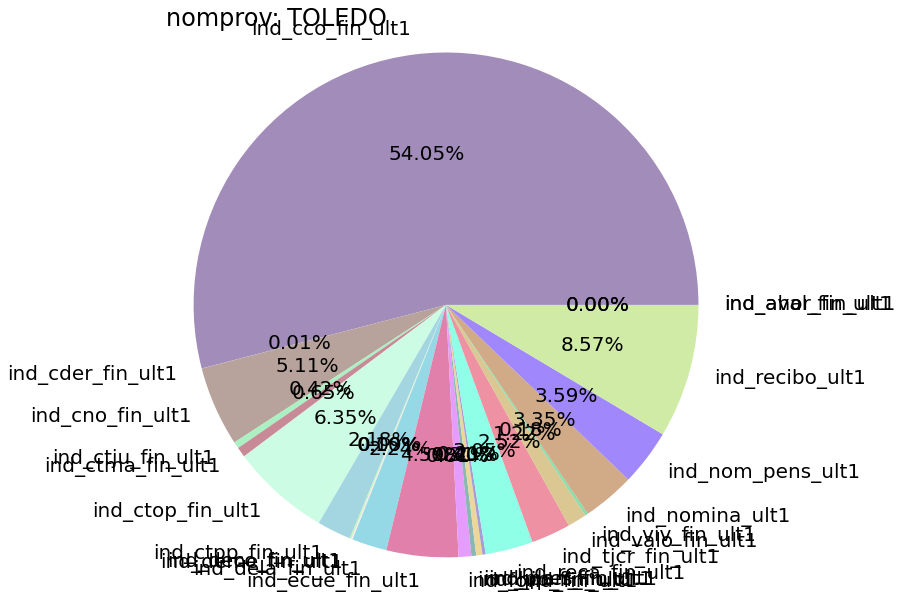

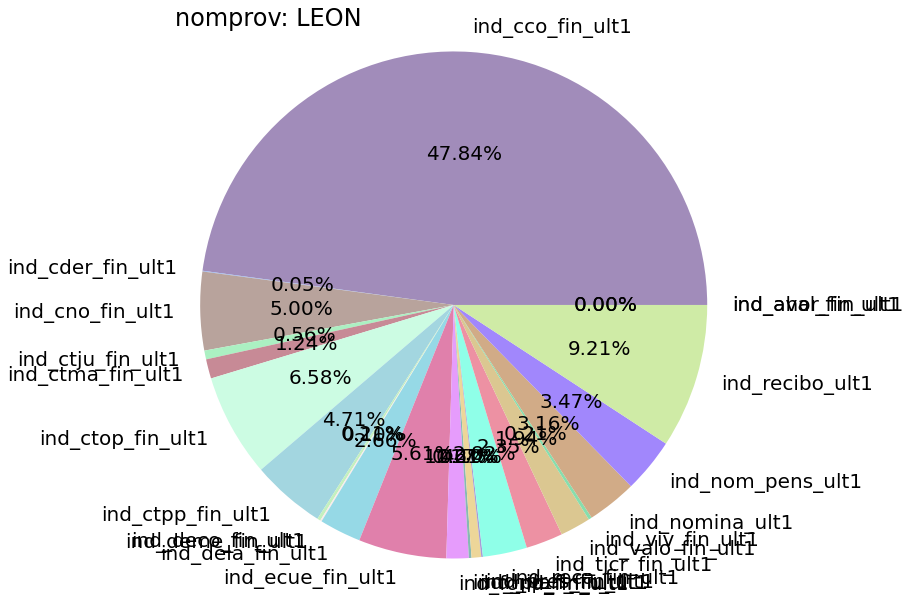

...

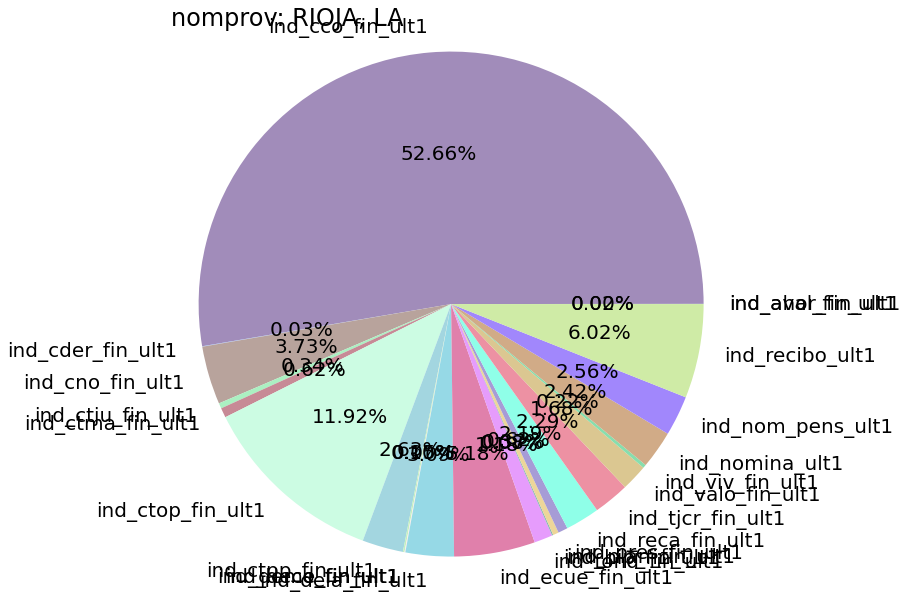

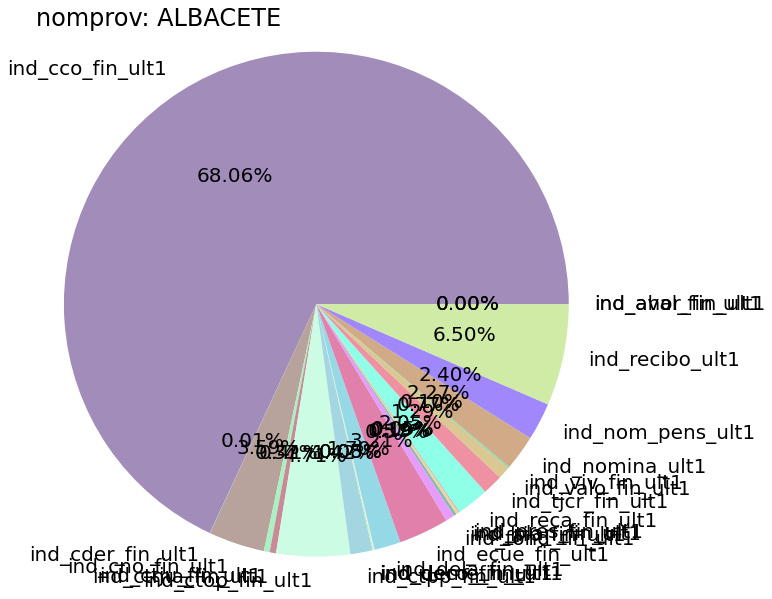

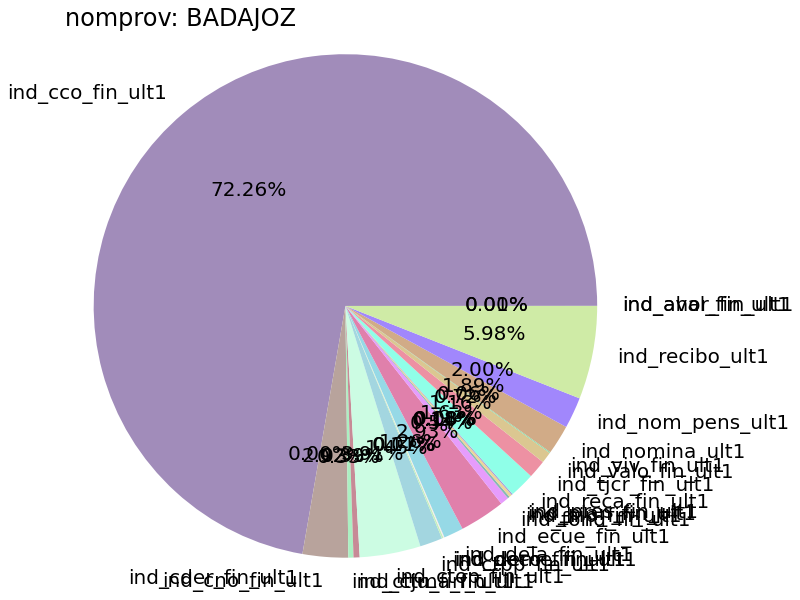

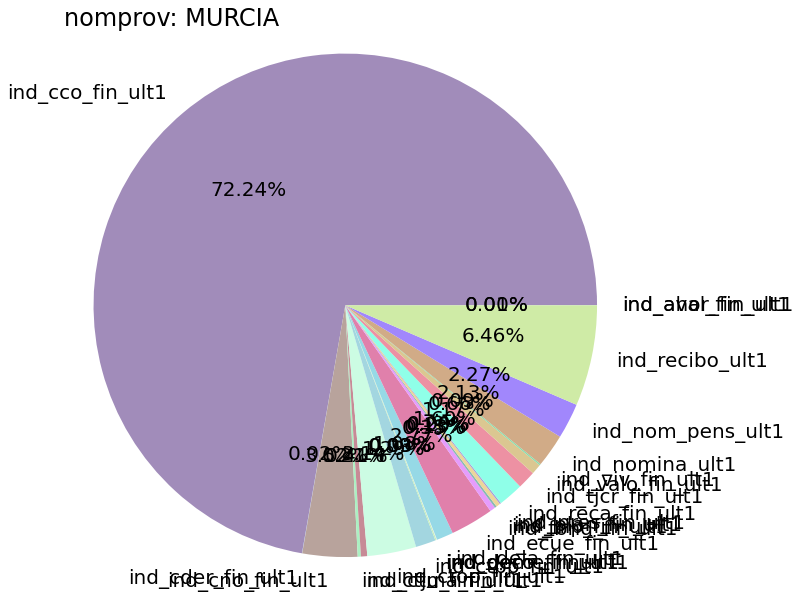

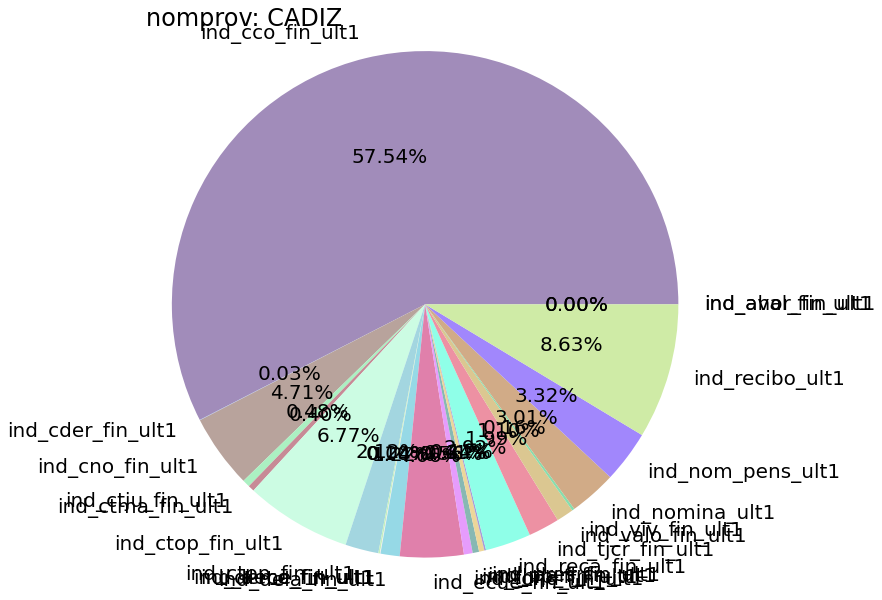

There is a Nan...


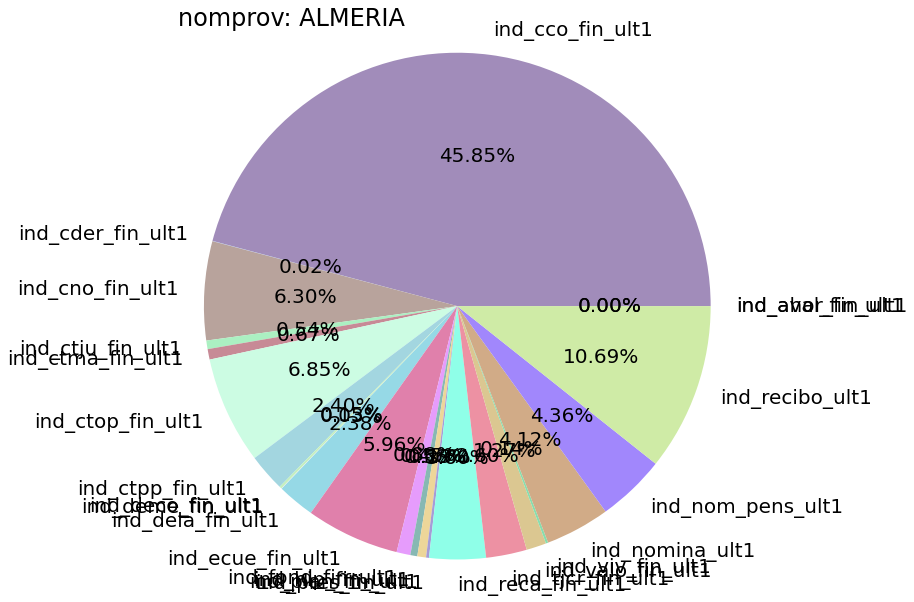

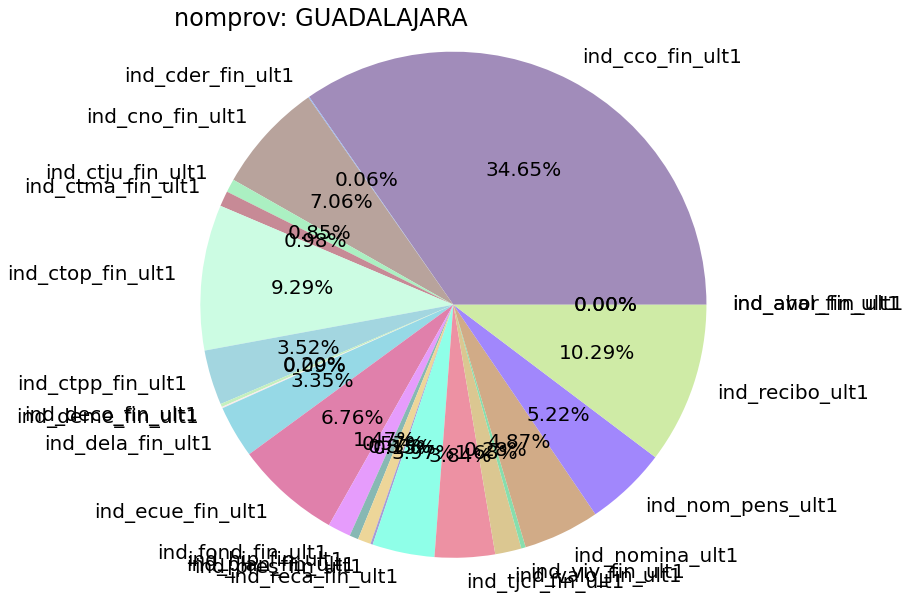

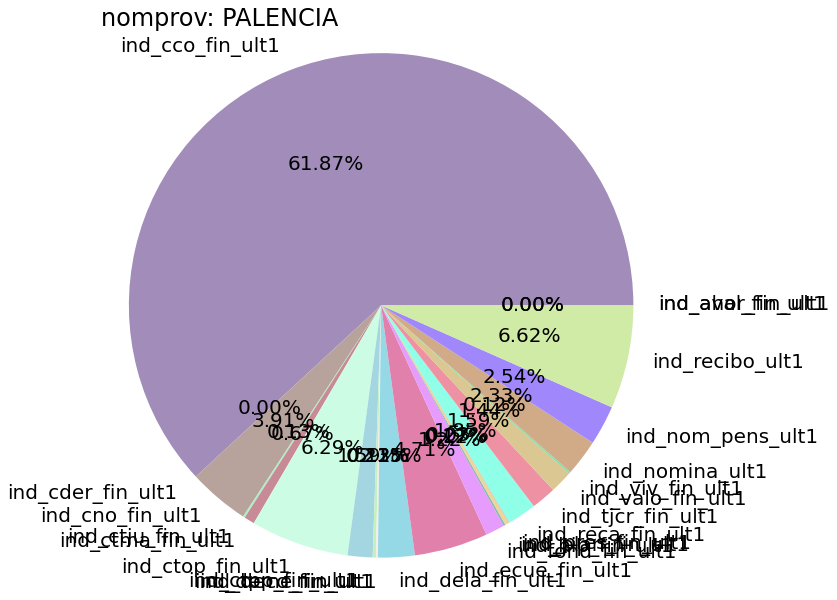

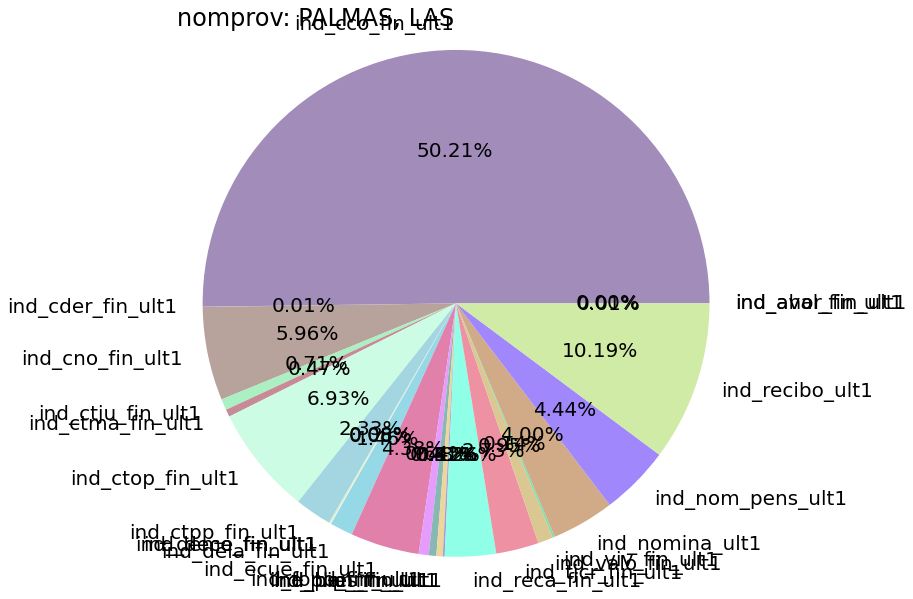

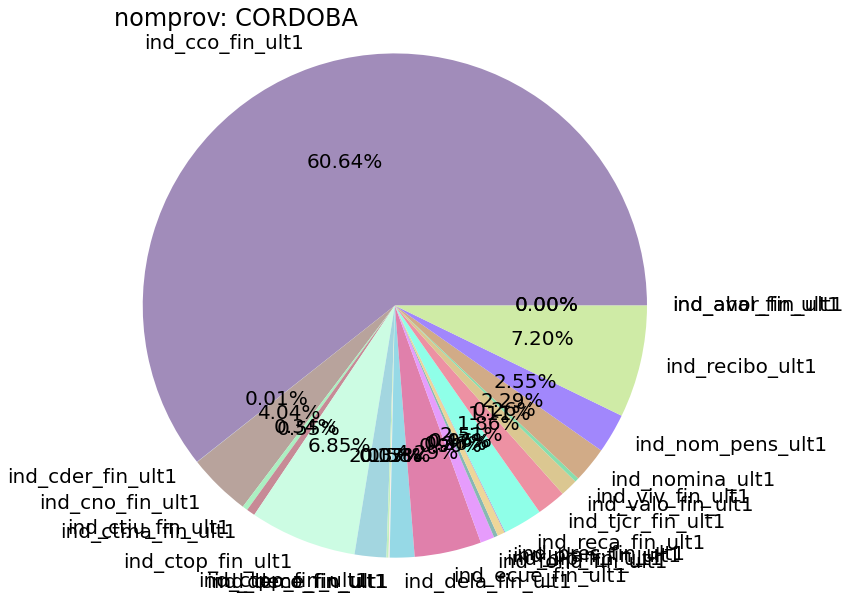

...

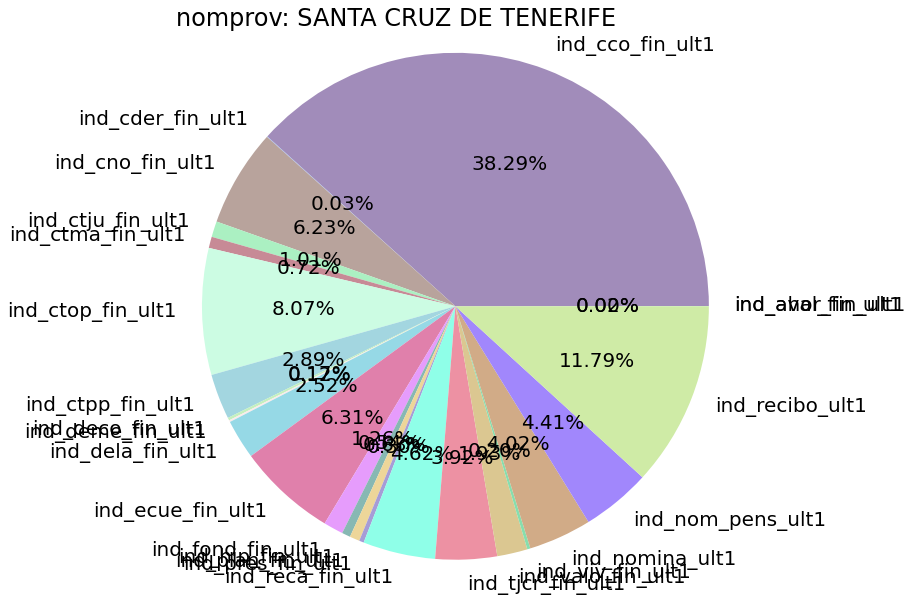

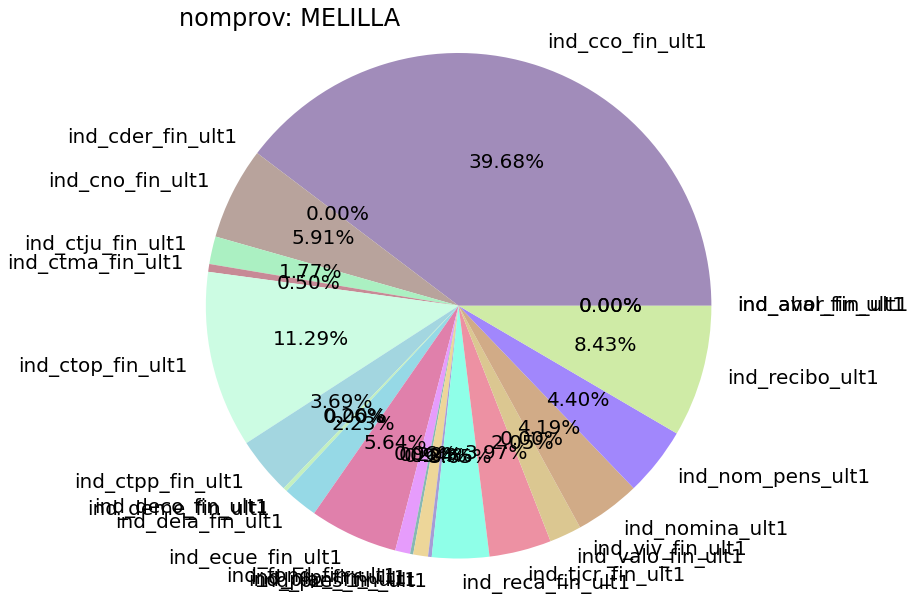

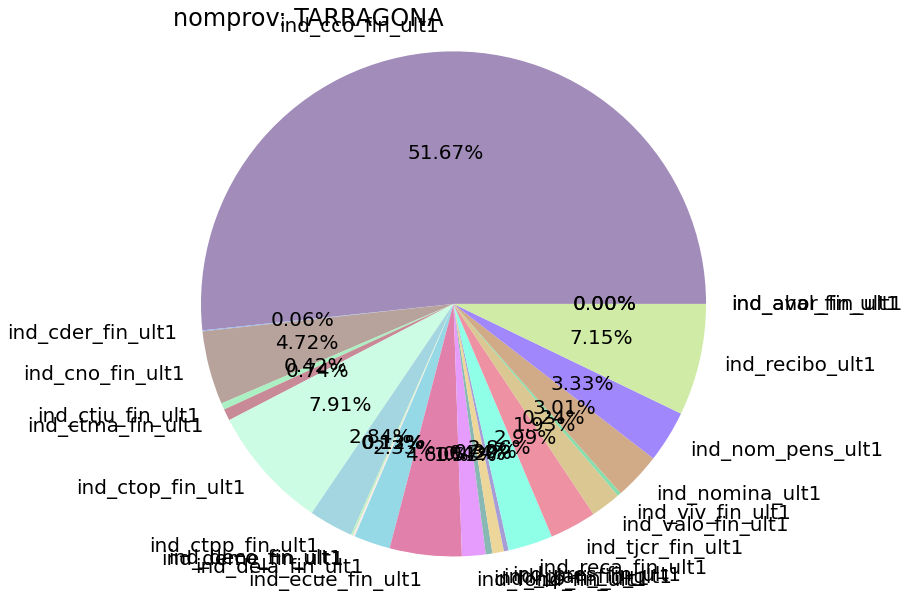

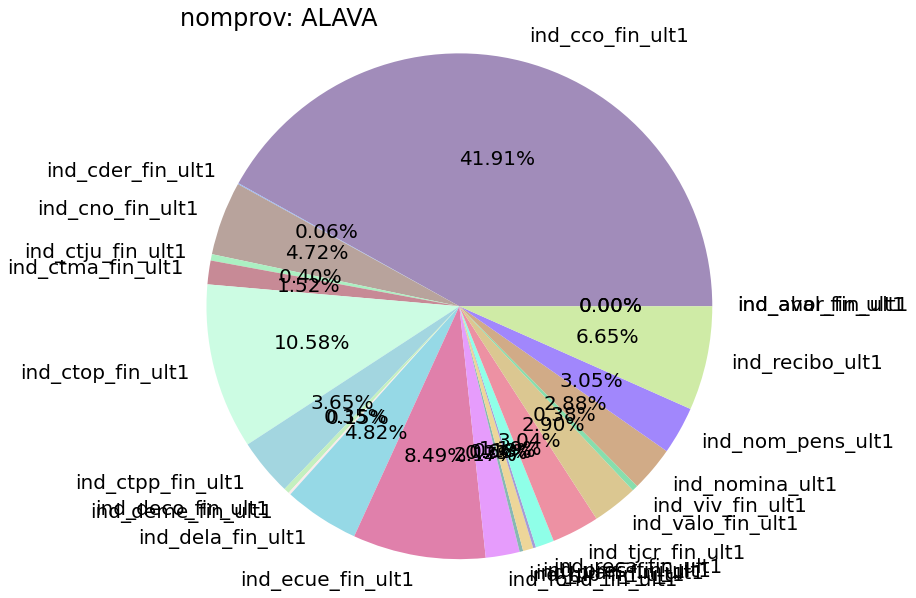

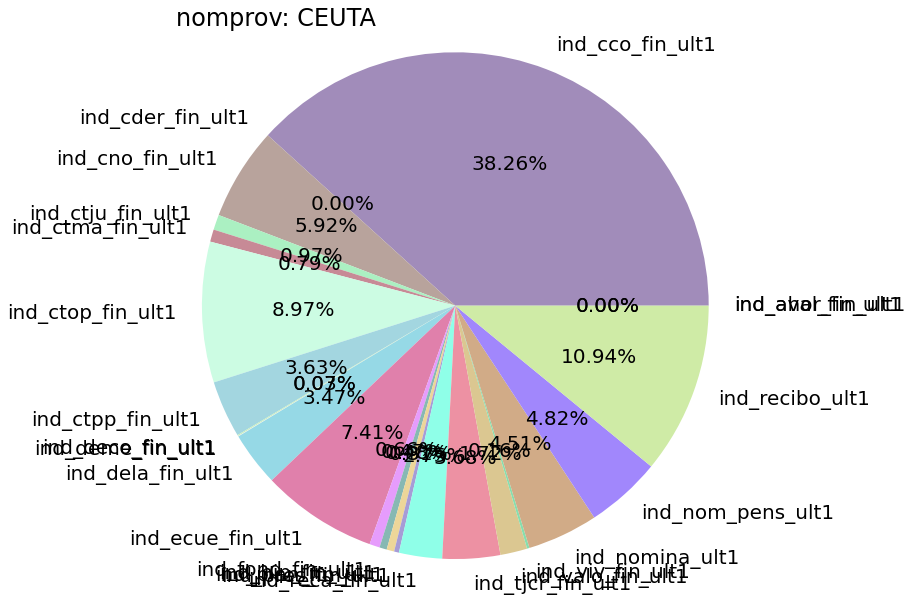

In [156]:
for nom in df.loc[:, 'nomprov'].unique():
    if pd.isna(nom):
        print("There is a Nan...")
        continue
    df_sum = df[df.loc[:, 'nomprov'] == nom].iloc[:,24:].sum()
    plt.figure(figsize = (10, 10))
    plt.pie(df_sum, labels = df_sum.index, autopct = '%1.2f%%', colors = colors, textprops={'fontsize': 20})
    plt.axis('equal')
    plt.title("nomprov: " + nom, fontsize=24, loc = 'left')
    plt.show()
    #plt.savefig("pie_chart_nomprov_" + seg + ".jpg")

There is a Nan...


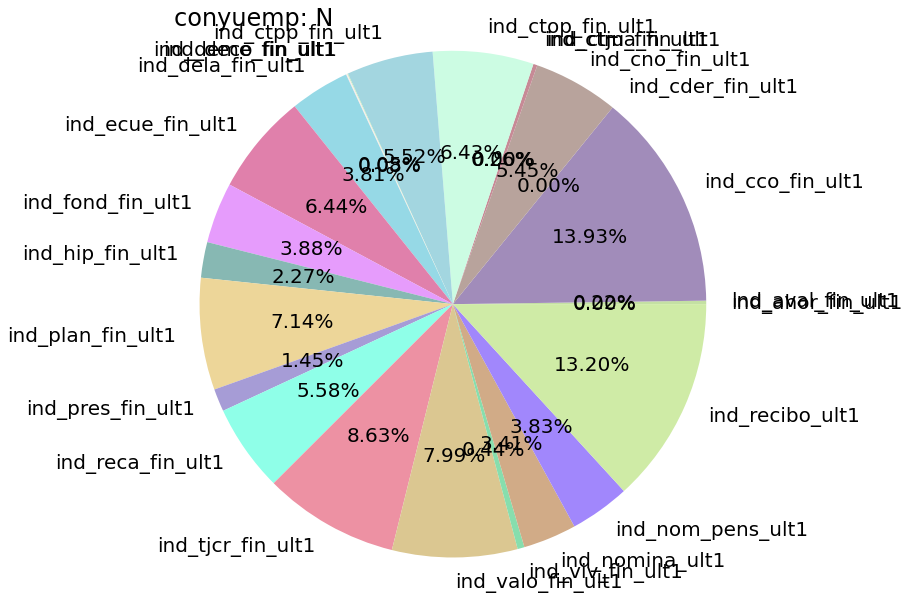

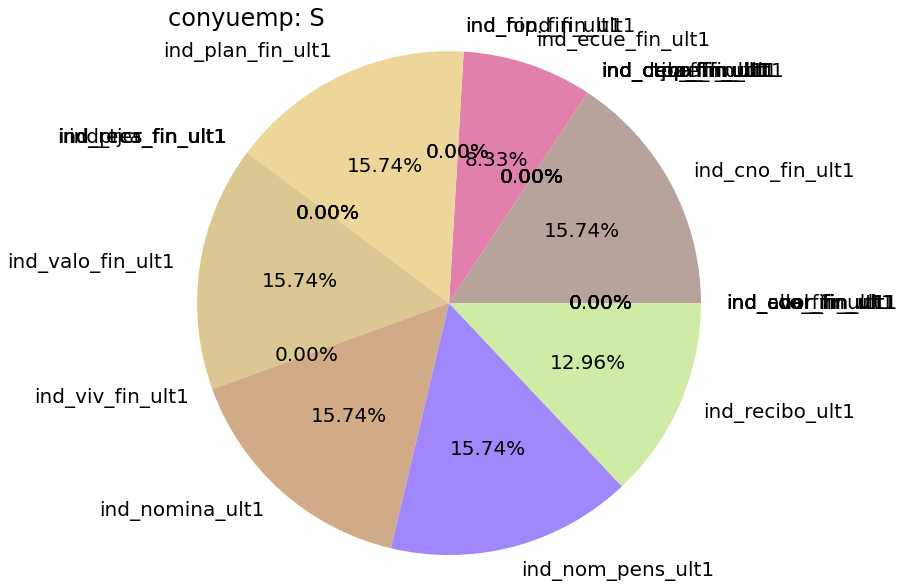

In [178]:
for i in df.loc[:, 'conyuemp'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    df_sum = df[df.loc[:, 'conyuemp'] == i].iloc[:,24:].sum()
    plt.figure(figsize = (10, 10))
    plt.pie(df_sum, labels = df_sum.index, autopct = '%1.2f%%', colors = colors, textprops={'fontsize': 20})
    plt.axis('equal')
    plt.title("conyuemp: " + i, fontsize=24, loc = 'left')
    plt.show()
    #plt.savefig("pie_chart_nomprov_" + seg + ".jpg")

### rule for all

In [182]:
df_temp = df.iloc[:,24:]
df_temp = df_temp.fillna(0)
freq = apriori(df_temp, min_support=0.05, use_colnames=True)
result = association_rules(freq, metric="confidence", min_threshold=0.66)
print("@For all ")
print(result.sort_values(by = ['confidence'],ascending=False))
result.sort_values(by = ['confidence'],ascending=False).to_csv("all" + "_0.05_0.66.csv")

@For all 
                              antecedents  \
5                       (ind_nomina_ult1)   
8     (ind_nomina_ult1, ind_cno_fin_ult1)   
1                       (ind_nomina_ult1)   
7    (ind_nomina_ult1, ind_nom_pens_ult1)   
10                      (ind_nomina_ult1)   
2                     (ind_nom_pens_ult1)   
9   (ind_nom_pens_ult1, ind_cno_fin_ult1)   
6                     (ind_nom_pens_ult1)   
11                    (ind_nom_pens_ult1)   
4                      (ind_cno_fin_ult1)   
3                      (ind_cno_fin_ult1)   
0                     (ind_ctop_fin_ult1)   

                              consequents  antecedent support  \
5                     (ind_nom_pens_ult1)            0.054660   
8                     (ind_nom_pens_ult1)            0.051391   
1                      (ind_cno_fin_ult1)            0.054660   
7                      (ind_cno_fin_ult1)            0.054660   
10  (ind_nom_pens_ult1, ind_cno_fin_ult1)            0.054660   
2             

In [184]:
temp = pd.read_csv("all" + "_0.05_0.66.csv")
temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
cols = ['antecedents','consequents']
temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
print("For all: ")
pd.set_option('display.max_colwidth', 100)
display(temp.head(20))

For all: 


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,ind_nomina_ult1,ind_cno_fin_ult1,0.940191
3,"ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.940191
4,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.940191
5,ind_nom_pens_ult1,ind_cno_fin_ult1,0.938339
6,"ind_nom_pens_ult1, ind_cno_fin_ult1",ind_nomina_ult1,0.922661
7,ind_nom_pens_ult1,ind_nomina_ult1,0.920843
8,ind_nom_pens_ult1,"ind_nomina_ult1, ind_cno_fin_ult1",0.865768
9,ind_cno_fin_ult1,ind_recibo_ult1,0.731040


### 分segmento算

In [149]:
for seg in df.loc[:, 'segmento'].unique():
    if pd.isna(seg):
        print("There is a Nan...")
        continue
    df_temp = df[df.loc[:, 'segmento'] == seg]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.75)
    print("@segmento " + seg)
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv("segmento_" + seg + "_0.025_0.75.csv")

@segmento 02 - PARTICULARES
                                               antecedents  \
11                     (ind_nomina_ult1, ind_cno_fin_ult1)   
26    (ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
3                                        (ind_nomina_ult1)   
21                      (ind_recibo_ult1, ind_nomina_ult1)   
15                      (ind_recibo_ult1, ind_nomina_ult1)   
25   (ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1)   
29                      (ind_recibo_ult1, ind_nomina_ult1)   
18                    (ind_recibo_ult1, ind_nom_pens_ult1)   
10                    (ind_nomina_ult1, ind_nom_pens_ult1)   
13                                       (ind_nomina_ult1)   
0                                        (ind_nomina_ult1)   
1                                      (ind_nom_pens_ult1)   
27  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1)   
22                    (ind_recibo_ult1, ind_nom_pens_ult1)   
12                   (ind_nom_pens_ult1, i

@segmento 03 - UNIVERSITARIO
Empty DataFrame
Columns: [antecedents, consequents, antecedent support, consequent support, support, confidence, lift, leverage, conviction]
Index: []
There is a Nan...
@segmento 01 - TOP
                                                                    antecedents  \
739   (ind_valo_fin_ult1, ind_reca_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
667   (ind_tjcr_fin_ult1, ind_ecue_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
833    (ind_recibo_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nomina_ult1)   
161                      (ind_nomina_ult1, ind_ctop_fin_ult1, ind_cno_fin_ult1)   
828    (ind_recibo_ult1, ind_reca_fin_ult1, ind_dela_fin_ult1, ind_nomina_ult1)   
..                                                                          ...   
75                                       (ind_reca_fin_ult1, ind_ctop_fin_ult1)   
646  (ind_recibo_ult1, ind_valo_fin_ult1, ind_reca_fin_ult1, ind_ecue_fin_ult1)   
703                    (ind_tjcr_fin

In [152]:
for seg in df.loc[:, 'segmento'].unique():
    if pd.isna(seg):
        print("There is a Nan...")
        continue
    temp = pd.read_csv("segmento_" + seg + "_0.025_0.75.csv")
    temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
    cols = ['antecedents','consequents']
    temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
    print("For segmento: " + seg)
    pd.set_option('display.max_colwidth', 100)
    display(temp.head(20))

For segmento: 02 - PARTICULARES


,antecedents,consequents,confidence
0,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
3,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.949291
5,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.949291
6,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.949291
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.947589
8,"ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.941503
9,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.941503


For segmento: 03 - UNIVERSITARIO


,antecedents,consequents,confidence


There is a Nan...
For segmento: 01 - TOP


,antecedents,consequents,confidence
0,"ind_valo_fin_ult1, ind_reca_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.0
1,"ind_tjcr_fin_ult1, ind_ecue_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.0
2,"ind_recibo_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.0
3,"ind_nomina_ult1, ind_ctop_fin_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.0
4,"ind_recibo_ult1, ind_reca_fin_ult1, ind_dela_fin_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.0
5,"ind_recibo_ult1, ind_ecue_fin_ult1, ind_dela_fin_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.0
6,"ind_nomina_ult1, ind_tjcr_fin_ult1, ind_ecue_fin_ult1, ind_dela_fin_ult1",ind_nom_pens_ult1,1.0
7,"ind_nomina_ult1, ind_reca_fin_ult1, ind_ecue_fin_ult1, ind_dela_fin_ult1",ind_nom_pens_ult1,1.0
8,"ind_recibo_ult1, ind_ctpp_fin_ult1, ind_nomina_ult1, ind_tjcr_fin_ult1",ind_nom_pens_ult1,1.0
9,"ind_recibo_ult1, ind_ctpp_fin_ult1, ind_reca_fin_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.0


### 分ind_empleado算

In [143]:
for emp in df.loc[:, 'ind_empleado'].unique():
    if pd.isna(emp):
        print("There is a Nan...")
        continue
    df_temp = df[df.loc[:, 'ind_empleado'] == emp]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.75)
    print("@ind_empleado " + emp)
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv("ind_emplead_" + emp + "_0.025_0.75.csv")

@ind_empleado N
                                               antecedents  \
2                                        (ind_nomina_ult1)   
20    (ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
15                      (ind_recibo_ult1, ind_nomina_ult1)   
7                      (ind_nomina_ult1, ind_cno_fin_ult1)   
23                      (ind_recibo_ult1, ind_nomina_ult1)   
19   (ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1)   
11                      (ind_recibo_ult1, ind_nomina_ult1)   
13                    (ind_recibo_ult1, ind_nom_pens_ult1)   
9                                        (ind_nomina_ult1)   
0                                        (ind_nomina_ult1)   
6                     (ind_nomina_ult1, ind_nom_pens_ult1)   
1                                      (ind_nom_pens_ult1)   
21  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1)   
16                    (ind_recibo_ult1, ind_nom_pens_ult1)   
8                    (ind_nom_pens_ult1, ind_cno_fin_u

@ind_empleado B
                                                                                        antecedents  \
730                                       (ind_ecue_fin_ult1, ind_dela_fin_ult1, ind_nom_pens_ult1)   
2469   (ind_recibo_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1)   
532                                         (ind_reca_fin_ult1, ind_hip_fin_ult1, ind_cno_fin_ult1)   
1641                    (ind_tjcr_fin_ult1, ind_nom_pens_ult1, ind_plan_fin_ult1, ind_cno_fin_ult1)   
2804  (ind_ecue_fin_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nom_pens_ult1, ind_nomina_ult1)   
...                                                                                             ...   
2831                     (ind_recibo_ult1, ind_reca_fin_ult1, ind_nom_pens_ult1, ind_plan_fin_ult1)   
2832                       (ind_recibo_ult1, ind_reca_fin_ult1, ind_nomina_ult1, ind_plan_fin_ult1)   
2835                     (ind_reca_fin_ult1, ind_nomina_u

In [151]:
for emp in df.loc[:, 'ind_empleado'].unique():
    if pd.isna(emp):
        print("There is a Nan...")
        continue
    temp = pd.read_csv("ind_emplead_" + emp + "_0.025_0.75.csv")
    temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
    cols = ['antecedents','consequents']
    temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
    print("For empleado: " + emp)
    pd.set_option('display.max_colwidth', 150)
    display(temp.head(20))
    

For empleado: N


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
3,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.949369
5,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.949369
6,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.949369
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.947915
8,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.940461
9,ind_nomina_ult1,ind_cno_fin_ult1,0.940461


There is a Nan...
For empleado: A


,antecedents,consequents,confidence
0,"ind_ecue_fin_ult1, ind_cco_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1","ind_recibo_ult1, ind_nom_pens_ult1",1.0
1,"ind_valo_fin_ult1, ind_cco_fin_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1",ind_recibo_ult1,1.0
2,"ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_plan_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.0
3,"ind_tjcr_fin_ult1, ind_cco_fin_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1",ind_recibo_ult1,1.0
4,"ind_ecue_fin_ult1, ind_tjcr_fin_ult1, ind_cco_fin_ult1, ind_ctop_fin_ult1, ind_nom_pens_ult1, ind_plan_fin_ult1",ind_recibo_ult1,1.0
5,"ind_recibo_ult1, ind_ecue_fin_ult1, ind_cco_fin_ult1, ind_ctop_fin_ult1, ind_nom_pens_ult1, ind_plan_fin_ult1",ind_tjcr_fin_ult1,1.0
6,"ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_plan_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_recibo_ult1,1.0
7,"ind_valo_fin_ult1, ind_cco_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.0
8,"ind_valo_fin_ult1, ind_cco_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_recibo_ult1,1.0
9,"ind_ecue_fin_ult1, ind_ctop_fin_ult1, ind_nom_pens_ult1, ind_dela_fin_ult1",ind_recibo_ult1,1.0


For empleado: B


,antecedents,consequents,confidence
0,"ind_ecue_fin_ult1, ind_dela_fin_ult1, ind_nom_pens_ult1",ind_recibo_ult1,1.0
1,"ind_recibo_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1",ind_nomina_ult1,1.0
2,"ind_reca_fin_ult1, ind_hip_fin_ult1, ind_cno_fin_ult1",ind_recibo_ult1,1.0
3,"ind_tjcr_fin_ult1, ind_nom_pens_ult1, ind_plan_fin_ult1, ind_cno_fin_ult1",ind_recibo_ult1,1.0
4,"ind_ecue_fin_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nom_pens_ult1, ind_nomina_ult1",ind_recibo_ult1,1.0
5,"ind_recibo_ult1, ind_nomina_ult1, ind_plan_fin_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.0
6,"ind_tjcr_fin_ult1, ind_hip_fin_ult1, ind_cno_fin_ult1",ind_recibo_ult1,1.0
7,"ind_recibo_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.0
8,"ind_recibo_ult1, ind_reca_fin_ult1, ind_tjcr_fin_ult1, ind_cco_fin_ult1, ind_cno_fin_ult1","ind_nomina_ult1, ind_nom_pens_ult1",1.0
9,"ind_tjcr_fin_ult1, ind_ecue_fin_ult1, ind_dela_fin_ult1, ind_nom_pens_ult1","ind_recibo_ult1, ind_nomina_ult1",1.0


For empleado: F


,antecedents,consequents,confidence
0,"ind_ecue_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.0
1,"ind_recibo_ult1, ind_tjcr_fin_ult1, ind_cco_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.0
2,"ind_plan_fin_ult1, ind_reca_fin_ult1, ind_tjcr_fin_ult1, ind_cno_fin_ult1",ind_recibo_ult1,1.0
3,"ind_valo_fin_ult1, ind_cco_fin_ult1, ind_nom_pens_ult1","ind_recibo_ult1, ind_nomina_ult1",1.0
4,"ind_valo_fin_ult1, ind_recibo_ult1, ind_cco_fin_ult1, ind_nom_pens_ult1, ind_nomina_ult1",ind_cno_fin_ult1,1.0
5,"ind_valo_fin_ult1, ind_ecue_fin_ult1, ind_ctpp_fin_ult1",ind_recibo_ult1,1.0
6,"ind_valo_fin_ult1, ind_recibo_ult1, ind_cco_fin_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1",ind_nomina_ult1,1.0
7,"ind_valo_fin_ult1, ind_recibo_ult1, ind_cco_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.0
8,"ind_valo_fin_ult1, ind_cco_fin_ult1, ind_nom_pens_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_recibo_ult1,1.0
9,"ind_ctpp_fin_ult1, ind_nomina_ult1, ind_plan_fin_ult1",ind_nom_pens_ult1,1.0


For empleado: S


,antecedents,consequents,confidence
0,ind_dela_fin_ult1,ind_cno_fin_ult1,1.0
1,"ind_recibo_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nomina_ult1","ind_ecue_fin_ult1, ind_nom_pens_ult1",1.0
2,"ind_recibo_ult1, ind_tjcr_fin_ult1, ind_ecue_fin_ult1, ind_dela_fin_ult1","ind_nomina_ult1, ind_nom_pens_ult1",1.0
3,"ind_ecue_fin_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nom_pens_ult1, ind_nomina_ult1",ind_recibo_ult1,1.0
4,"ind_recibo_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nom_pens_ult1, ind_nomina_ult1",ind_ecue_fin_ult1,1.0
5,"ind_recibo_ult1, ind_ecue_fin_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.0
6,"ind_recibo_ult1, ind_ecue_fin_ult1, ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nom_pens_ult1",ind_nomina_ult1,1.0
7,"ind_tjcr_fin_ult1, ind_dela_fin_ult1","ind_recibo_ult1, ind_valo_fin_ult1, ind_ecue_fin_ult1, ind_nom_pens_ult1",1.0
8,"ind_tjcr_fin_ult1, ind_dela_fin_ult1, ind_nom_pens_ult1","ind_recibo_ult1, ind_valo_fin_ult1, ind_ecue_fin_ult1",1.0
9,"ind_tjcr_fin_ult1, ind_ecue_fin_ult1, ind_dela_fin_ult1","ind_recibo_ult1, ind_valo_fin_ult1, ind_nom_pens_ult1",1.0


### 分月份算（全部顧客的購物清單一起）

In [6]:
for month in df.loc[:, 'fecha_dato'].unique():
    df_temp = df[df.loc[:, 'fecha_dato'] == month]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.66)
    print("@" + month)
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv(month + "_0.025_0.66.csv")

@2015-01-28
                                          antecedents  \
18                (ind_nomina_ult1, ind_cno_fin_ult1)   
30                 (ind_nomina_ult1, ind_recibo_ult1)   
36  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
7                                   (ind_nomina_ult1)   
35  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
22                 (ind_nomina_ult1, ind_recibo_ult1)   
39                 (ind_nomina_ult1, ind_recibo_ult1)   
26               (ind_recibo_ult1, ind_nom_pens_ult1)   
11             (ind_ecue_fin_ult1, ind_nom_pens_ult1)   
20                                  (ind_nomina_ult1)   
2                                   (ind_nomina_ult1)   
17               (ind_nomina_ult1, ind_nom_pens_ult1)   
3                                 (ind_nom_pens_ult1)   
37  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
31               (ind_recibo_ult1, ind_nom_pens_ult1)   
19              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
8                  

@2015-02-28
                                          antecedents  \
18                (ind_nomina_ult1, ind_cno_fin_ult1)   
32                 (ind_nomina_ult1, ind_recibo_ult1)   
38  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
30               (ind_nomina_ult1, ind_ecue_fin_ult1)   
7                                   (ind_nomina_ult1)   
11             (ind_ecue_fin_ult1, ind_nom_pens_ult1)   
26               (ind_recibo_ult1, ind_nom_pens_ult1)   
37  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
22                 (ind_nomina_ult1, ind_recibo_ult1)   
41                 (ind_nomina_ult1, ind_recibo_ult1)   
3                                 (ind_nom_pens_ult1)   
20                                  (ind_nomina_ult1)   
2                                   (ind_nomina_ult1)   
17               (ind_nomina_ult1, ind_nom_pens_ult1)   
33               (ind_recibo_ult1, ind_nom_pens_ult1)   
39  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
8                  

@2015-03-28
                                          antecedents  \
50  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
44  (ind_nomina_ult1, ind_ecue_fin_ult1, ind_cno_f...   
38                 (ind_nomina_ult1, ind_recibo_ult1)   
36               (ind_tjcr_fin_ult1, ind_nomina_ult1)   
8                                   (ind_nomina_ult1)   
..                                                ...   
16               (ind_ecue_fin_ult1, ind_recibo_ult1)   
1                                 (ind_dela_fin_ult1)   
25                                 (ind_cno_fin_ult1)   
3                                  (ind_cno_fin_ult1)   
0                                 (ind_ctop_fin_ult1)   

                             consequents  antecedent support  \
50                   (ind_nom_pens_ult1)            0.052173   
44                   (ind_nom_pens_ult1)            0.025891   
38                   (ind_nom_pens_ult1)            0.054351   
36                   (ind_nom_pens_ult1)       

@2015-06-28
                                          antecedents  \
39               (ind_tjcr_fin_ult1, ind_nomina_ult1)   
41                 (ind_nomina_ult1, ind_recibo_ult1)   
47  (ind_nomina_ult1, ind_ecue_fin_ult1, ind_cno_f...   
8                                   (ind_nomina_ult1)   
23                (ind_nomina_ult1, ind_cno_fin_ult1)   
..                                                ...   
63                                (ind_nom_pens_ult1)   
27                                 (ind_cno_fin_ult1)   
3                                  (ind_cno_fin_ult1)   
1                                 (ind_dela_fin_ult1)   
0                                 (ind_ctop_fin_ult1)   

                                          consequents  antecedent support  \
39                                (ind_nom_pens_ult1)            0.025214   
41                                (ind_nom_pens_ult1)            0.054264   
47                                (ind_nom_pens_ult1)            0.02558

@2015-08-28
                                          antecedents  \
24                 (ind_nomina_ult1, ind_recibo_ult1)   
30  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
7                                   (ind_nomina_ult1)   
12                (ind_nomina_ult1, ind_cno_fin_ult1)   
33                 (ind_nomina_ult1, ind_recibo_ult1)   
16                 (ind_nomina_ult1, ind_recibo_ult1)   
29  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
20               (ind_recibo_ult1, ind_nom_pens_ult1)   
11               (ind_nomina_ult1, ind_nom_pens_ult1)   
14                                  (ind_nomina_ult1)   
2                                   (ind_nomina_ult1)   
3                                 (ind_nom_pens_ult1)   
31  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
13              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
25               (ind_recibo_ult1, ind_nom_pens_ult1)   
8                                 (ind_nom_pens_ult1)   
34               (i

@2015-09-28
                                          antecedents  \
24                 (ind_nomina_ult1, ind_recibo_ult1)   
30  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
7                                   (ind_nomina_ult1)   
12                (ind_nomina_ult1, ind_cno_fin_ult1)   
33                 (ind_nomina_ult1, ind_recibo_ult1)   
16                 (ind_nomina_ult1, ind_recibo_ult1)   
29  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
20               (ind_recibo_ult1, ind_nom_pens_ult1)   
11               (ind_nomina_ult1, ind_nom_pens_ult1)   
14                                  (ind_nomina_ult1)   
2                                   (ind_nomina_ult1)   
3                                 (ind_nom_pens_ult1)   
31  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
13              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
25               (ind_recibo_ult1, ind_nom_pens_ult1)   
8                                 (ind_nom_pens_ult1)   
34               (i

@2015-10-28
                                          antecedents  \
11                (ind_nomina_ult1, ind_cno_fin_ult1)   
23                 (ind_nomina_ult1, ind_recibo_ult1)   
6                                   (ind_nomina_ult1)   
29  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
19               (ind_recibo_ult1, ind_nom_pens_ult1)   
28  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
32                 (ind_nomina_ult1, ind_recibo_ult1)   
15                 (ind_nomina_ult1, ind_recibo_ult1)   
2                                 (ind_nom_pens_ult1)   
1                                   (ind_nomina_ult1)   
13                                  (ind_nomina_ult1)   
10               (ind_nomina_ult1, ind_nom_pens_ult1)   
24               (ind_recibo_ult1, ind_nom_pens_ult1)   
30  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
7                                 (ind_nom_pens_ult1)   
12              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
33               (i

@2015-11-28
                                          antecedents  \
6                                   (ind_nomina_ult1)   
11                (ind_nomina_ult1, ind_cno_fin_ult1)   
23                 (ind_nomina_ult1, ind_recibo_ult1)   
29  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
28  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
15                 (ind_nomina_ult1, ind_recibo_ult1)   
32                 (ind_nomina_ult1, ind_recibo_ult1)   
19               (ind_recibo_ult1, ind_nom_pens_ult1)   
10               (ind_nomina_ult1, ind_nom_pens_ult1)   
1                                   (ind_nomina_ult1)   
13                                  (ind_nomina_ult1)   
2                                 (ind_nom_pens_ult1)   
30  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
12              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
24               (ind_recibo_ult1, ind_nom_pens_ult1)   
7                                 (ind_nom_pens_ult1)   
33               (i

@2015-12-28
                                          antecedents  \
32  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
26                 (ind_nomina_ult1, ind_recibo_ult1)   
13                (ind_nomina_ult1, ind_cno_fin_ult1)   
8                                   (ind_nomina_ult1)   
31  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
35                 (ind_nomina_ult1, ind_recibo_ult1)   
18                 (ind_nomina_ult1, ind_recibo_ult1)   
22               (ind_recibo_ult1, ind_nom_pens_ult1)   
12               (ind_nomina_ult1, ind_nom_pens_ult1)   
2                                   (ind_nomina_ult1)   
15                                  (ind_nomina_ult1)   
4                                 (ind_nom_pens_ult1)   
33  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
27               (ind_recibo_ult1, ind_nom_pens_ult1)   
14              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
9                                 (ind_nom_pens_ult1)   
36               (i

@2016-01-28
                                          antecedents  \
6                                   (ind_nomina_ult1)   
27  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
11                (ind_nomina_ult1, ind_cno_fin_ult1)   
21                 (ind_nomina_ult1, ind_recibo_ult1)   
28  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
22               (ind_recibo_ult1, ind_nom_pens_ult1)   
12              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
7                                 (ind_nom_pens_ult1)   
30                 (ind_nomina_ult1, ind_recibo_ult1)   
15                 (ind_nomina_ult1, ind_recibo_ult1)   
26  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
18               (ind_recibo_ult1, ind_nom_pens_ult1)   
10               (ind_nomina_ult1, ind_nom_pens_ult1)   
13                                  (ind_nomina_ult1)   
2                                   (ind_nomina_ult1)   
3                                 (ind_nom_pens_ult1)   
31               (i

@2016-03-28
                                          antecedents  \
28  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
22                 (ind_nomina_ult1, ind_recibo_ult1)   
5                                   (ind_nomina_ult1)   
10                (ind_nomina_ult1, ind_cno_fin_ult1)   
14                 (ind_nomina_ult1, ind_recibo_ult1)   
27  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
31                 (ind_nomina_ult1, ind_recibo_ult1)   
18               (ind_recibo_ult1, ind_nom_pens_ult1)   
9                (ind_nomina_ult1, ind_nom_pens_ult1)   
12                                  (ind_nomina_ult1)   
0                                   (ind_nomina_ult1)   
1                                 (ind_nom_pens_ult1)   
29  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
11              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
23               (ind_recibo_ult1, ind_nom_pens_ult1)   
6                                 (ind_nom_pens_ult1)   
32               (i

@2016-04-28
                                          antecedents  \
28  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
5                                   (ind_nomina_ult1)   
22                 (ind_nomina_ult1, ind_recibo_ult1)   
10                (ind_nomina_ult1, ind_cno_fin_ult1)   
27  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
31                 (ind_nomina_ult1, ind_recibo_ult1)   
14                 (ind_nomina_ult1, ind_recibo_ult1)   
18               (ind_recibo_ult1, ind_nom_pens_ult1)   
0                                   (ind_nomina_ult1)   
12                                  (ind_nomina_ult1)   
9                (ind_nomina_ult1, ind_nom_pens_ult1)   
1                                 (ind_nom_pens_ult1)   
29  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
11              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
23               (ind_recibo_ult1, ind_nom_pens_ult1)   
6                                 (ind_nom_pens_ult1)   
32               (i

@2016-05-28
                                          antecedents  \
28  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
22                 (ind_nomina_ult1, ind_recibo_ult1)   
5                                   (ind_nomina_ult1)   
10                (ind_nomina_ult1, ind_cno_fin_ult1)   
14                 (ind_nomina_ult1, ind_recibo_ult1)   
27  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
31                 (ind_nomina_ult1, ind_recibo_ult1)   
18               (ind_recibo_ult1, ind_nom_pens_ult1)   
9                (ind_nomina_ult1, ind_nom_pens_ult1)   
12                                  (ind_nomina_ult1)   
0                                   (ind_nomina_ult1)   
1                                 (ind_nom_pens_ult1)   
29  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
11              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
23               (ind_recibo_ult1, ind_nom_pens_ult1)   
6                                 (ind_nom_pens_ult1)   
32               (i

In [185]:
for month in df.loc[:, 'fecha_dato'].unique():
    df_temp = df[df.loc[:, 'fecha_dato'] == month]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.05, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.75)
    print("@" + month)
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv(month + "_0.05_0.75.csv")

@2015-01-28
                              antecedents  \
3                       (ind_nomina_ult1)   
7     (ind_nomina_ult1, ind_cno_fin_ult1)   
11   (ind_recibo_ult1, ind_nom_pens_ult1)   
0                       (ind_nomina_ult1)   
6    (ind_nomina_ult1, ind_nom_pens_ult1)   
9                       (ind_nomina_ult1)   
1                     (ind_nom_pens_ult1)   
8   (ind_nom_pens_ult1, ind_cno_fin_ult1)   
4                     (ind_nom_pens_ult1)   
10                    (ind_nom_pens_ult1)   
12  (ind_nom_pens_ult1, ind_cno_fin_ult1)   
5                     (ind_nom_pens_ult1)   
13                    (ind_nom_pens_ult1)   
2                      (ind_cno_fin_ult1)   

                              consequents  antecedent support  \
3                     (ind_nom_pens_ult1)            0.062346   
7                     (ind_nom_pens_ult1)            0.059320   
11                     (ind_cno_fin_ult1)            0.055112   
0                      (ind_cno_fin_ult1)           

@2015-04-28
                                               antecedents  \
2                                        (ind_nomina_ult1)   
23    (ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
18                      (ind_recibo_ult1, ind_nomina_ult1)   
7                      (ind_nomina_ult1, ind_cno_fin_ult1)   
14                    (ind_recibo_ult1, ind_nom_pens_ult1)   
26                      (ind_recibo_ult1, ind_nomina_ult1)   
11                      (ind_recibo_ult1, ind_nomina_ult1)   
22   (ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1)   
1                                      (ind_nom_pens_ult1)   
0                                        (ind_nomina_ult1)   
6                     (ind_nomina_ult1, ind_nom_pens_ult1)   
9                                        (ind_nomina_ult1)   
19                    (ind_recibo_ult1, ind_nom_pens_ult1)   
24  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1)   
3                                      (ind_nom_pens_ult1)

@2015-06-28
                                               antecedents  \
9                      (ind_nomina_ult1, ind_cno_fin_ult1)   
24    (ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
4                                        (ind_nomina_ult1)   
19                      (ind_recibo_ult1, ind_nomina_ult1)   
27                      (ind_recibo_ult1, ind_nomina_ult1)   
23   (ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1)   
13                      (ind_recibo_ult1, ind_nomina_ult1)   
16                    (ind_recibo_ult1, ind_nom_pens_ult1)   
11                                       (ind_nomina_ult1)   
0                                        (ind_nomina_ult1)   
8                     (ind_nomina_ult1, ind_nom_pens_ult1)   
1                                      (ind_nom_pens_ult1)   
25  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1)   
10                   (ind_nom_pens_ult1, ind_cno_fin_ult1)   
20                    (ind_recibo_ult1, ind_nom_pens_ult1)

@2015-08-28
           antecedents          consequents  antecedent support  \
1    (ind_nomina_ult1)  (ind_nom_pens_ult1)            0.050745   
0  (ind_nom_pens_ult1)   (ind_cno_fin_ult1)            0.055811   
2  (ind_nom_pens_ult1)    (ind_nomina_ult1)            0.055811   

   consequent support   support  confidence       lift  leverage  conviction  
1            0.055811  0.050745    1.000000  17.917573  0.047913         inf  
0            0.074712  0.052337    0.937760  12.551716  0.048168   14.866530  
2            0.050745  0.050745    0.909222  17.917573  0.047913   10.456918  
@2015-09-28
           antecedents          consequents  antecedent support  \
1    (ind_nomina_ult1)  (ind_nom_pens_ult1)            0.050463   
0  (ind_nom_pens_ult1)   (ind_cno_fin_ult1)            0.055461   
2  (ind_nom_pens_ult1)    (ind_nomina_ult1)            0.055461   

   consequent support   support  confidence       lift  leverage  conviction  
1            0.055461  0.050463    1.000000

In [186]:
for month in df.loc[:, 'fecha_dato'].unique():
    temp = pd.read_csv(month + "_0.05_0.75.csv")
    temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
    cols = ['antecedents','consequents']
    temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
    print("For " + month)
    pd.set_option('display.max_colwidth', 100)
    display(temp.head(20))

For 2015-01-28


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.960923
3,ind_nomina_ult1,ind_cno_fin_ult1,0.951455
4,"ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.951455
5,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.951455
6,ind_nom_pens_ult1,ind_cno_fin_ult1,0.949367
7,"ind_nom_pens_ult1, ind_cno_fin_ult1",ind_nomina_ult1,0.901913
8,ind_nom_pens_ult1,ind_nomina_ult1,0.899933
9,ind_nom_pens_ult1,"ind_nomina_ult1, ind_cno_fin_ult1",0.856246


For 2015-02-28


,antecedents,consequents,confidence
0,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
1,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
3,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.964120
4,ind_nom_pens_ult1,ind_cno_fin_ult1,0.952399
5,ind_nomina_ult1,ind_cno_fin_ult1,0.951971
6,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.951971
7,"ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.951971
8,"ind_recibo_ult1, ind_nom_pens_ult1",ind_nomina_ult1,0.912636
9,ind_nom_pens_ult1,ind_nomina_ult1,0.909306


For 2015-03-28


,antecedents,consequents,confidence
0,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
1,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
3,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1",ind_nomina_ult1,0.975746
5,"ind_recibo_ult1, ind_nom_pens_ult1",ind_nomina_ult1,0.975386
6,"ind_nom_pens_ult1, ind_cno_fin_ult1",ind_nomina_ult1,0.975171
7,ind_nom_pens_ult1,ind_nomina_ult1,0.974110
8,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.959939
9,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.959939


For 2015-04-28


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
3,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.961642
5,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.960784
6,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.960784
7,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.960784
8,ind_nom_pens_ult1,ind_cno_fin_ult1,0.949713
9,ind_nomina_ult1,ind_cno_fin_ult1,0.949485


For 2015-05-28


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
2,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
3,"ind_recibo_ult1, ind_nom_pens_ult1",ind_nomina_ult1,0.975764
4,"ind_nom_pens_ult1, ind_cno_fin_ult1",ind_nomina_ult1,0.975006
5,ind_nom_pens_ult1,ind_nomina_ult1,0.974681
6,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.963059
7,ind_nomina_ult1,ind_cno_fin_ult1,0.953942
8,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.953942
9,"ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.953942


For 2015-06-28


,antecedents,consequents,confidence
0,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
3,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.956444
5,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.956444
6,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.956444
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.953284
8,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.944169
9,ind_nomina_ult1,ind_cno_fin_ult1,0.944169


For 2015-07-28


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,ind_nomina_ult1,ind_cno_fin_ult1,0.935220
3,"ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.935220
4,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.935220
5,ind_nom_pens_ult1,ind_cno_fin_ult1,0.933292
6,"ind_nom_pens_ult1, ind_cno_fin_ult1",ind_nomina_ult1,0.908062
7,ind_nom_pens_ult1,ind_nomina_ult1,0.906189
8,ind_nom_pens_ult1,"ind_nomina_ult1, ind_cno_fin_ult1",0.847486
9,ind_cno_fin_ult1,ind_recibo_ult1,0.753177


For 2015-08-28


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,ind_nom_pens_ult1,ind_cno_fin_ult1,0.937760
2,ind_nom_pens_ult1,ind_nomina_ult1,0.909222


For 2015-09-28


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,ind_nom_pens_ult1,ind_cno_fin_ult1,0.930747
2,ind_nom_pens_ult1,ind_nomina_ult1,0.909892


For 2015-10-28


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,ind_nom_pens_ult1,ind_cno_fin_ult1,0.932960
2,ind_nom_pens_ult1,ind_nomina_ult1,0.913306


For 2015-11-28


,antecedents,consequents,confidence
0,ind_nom_pens_ult1,ind_cno_fin_ult1,0.928943


For 2015-12-28


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,ind_nom_pens_ult1,ind_cno_fin_ult1,0.937364
2,ind_nom_pens_ult1,ind_nomina_ult1,0.916210


For 2016-01-28


,antecedents,consequents,confidence


For 2016-02-28


,antecedents,consequents,confidence
0,ind_nom_pens_ult1,ind_cno_fin_ult1,0.929283


For 2016-03-28


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,ind_nom_pens_ult1,ind_cno_fin_ult1,0.931420
2,ind_nom_pens_ult1,ind_nomina_ult1,0.923722


For 2016-04-28


,antecedents,consequents,confidence
0,ind_nom_pens_ult1,ind_cno_fin_ult1,0.93529


For 2016-05-28


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,ind_nom_pens_ult1,ind_cno_fin_ult1,0.930896
2,ind_nom_pens_ult1,ind_nomina_ult1,0.914112


### 分顧客性別算（個別顧客每個月的清單）

In [7]:
for s in ['H', 'V']:
    df_temp = df[df.loc[:, 'sexo'] == s]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.66)
    print("@sexo: " + s)
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv( "sexo_" + s + "_0.025_0.66.csv")

@sexo: H
                                          antecedents  \
28  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
22                 (ind_nomina_ult1, ind_recibo_ult1)   
10                (ind_nomina_ult1, ind_cno_fin_ult1)   
5                                   (ind_nomina_ult1)   
14                 (ind_nomina_ult1, ind_recibo_ult1)   
27  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
31                 (ind_nomina_ult1, ind_recibo_ult1)   
18               (ind_recibo_ult1, ind_nom_pens_ult1)   
9                (ind_nomina_ult1, ind_nom_pens_ult1)   
12                                  (ind_nomina_ult1)   
1                                   (ind_nomina_ult1)   
2                                 (ind_nom_pens_ult1)   
29  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
23               (ind_recibo_ult1, ind_nom_pens_ult1)   
11              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
6                                 (ind_nom_pens_ult1)   
32               (ind_

@sexo: V
                                          antecedents  \
33  (ind_nomina_ult1, ind_recibo_ult1, ind_cno_fin...   
7                                   (ind_nomina_ult1)   
15                (ind_nomina_ult1, ind_cno_fin_ult1)   
27                 (ind_nomina_ult1, ind_recibo_ult1)   
19                 (ind_nomina_ult1, ind_recibo_ult1)   
36                 (ind_nomina_ult1, ind_recibo_ult1)   
32  (ind_nomina_ult1, ind_recibo_ult1, ind_nom_pen...   
23               (ind_recibo_ult1, ind_nom_pens_ult1)   
14               (ind_nomina_ult1, ind_nom_pens_ult1)   
2                                   (ind_nomina_ult1)   
17                                  (ind_nomina_ult1)   
3                                 (ind_nom_pens_ult1)   
34  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_f...   
16              (ind_nom_pens_ult1, ind_cno_fin_ult1)   
28               (ind_recibo_ult1, ind_nom_pens_ult1)   
8                                 (ind_nom_pens_ult1)   
13              (ind_t

In [136]:
for s in ['H', 'V']:
    df_temp = df[df.loc[:, 'sexo'] == s]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.75)
    print("@sexo: " + s)
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv( "sexo_" + s + "_0.025_0.75.csv")

@sexo: H
                                               antecedents  \
2                                        (ind_nomina_ult1)   
21    (ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
16                      (ind_recibo_ult1, ind_nomina_ult1)   
7                      (ind_nomina_ult1, ind_cno_fin_ult1)   
24                      (ind_recibo_ult1, ind_nomina_ult1)   
20   (ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1)   
11                      (ind_recibo_ult1, ind_nomina_ult1)   
13                    (ind_recibo_ult1, ind_nom_pens_ult1)   
9                                        (ind_nomina_ult1)   
0                                        (ind_nomina_ult1)   
6                     (ind_nomina_ult1, ind_nom_pens_ult1)   
1                                      (ind_nom_pens_ult1)   
22  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1)   
17                    (ind_recibo_ult1, ind_nom_pens_ult1)   
8                    (ind_nom_pens_ult1, ind_cno_fin_ult1)   

In [139]:
for s in ['H', 'V']:    
    temp = pd.read_csv("sexo_" + s + "_0.025_0.75.csv")
    temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
    cols = ['antecedents','consequents']
    temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
    print("For gender: " + s)
    pd.set_option('display.max_colwidth', 100)
    display(temp.head(20))

For gender: H


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
3,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.953298
5,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.953298
6,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.953298
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.952491
8,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.943832
9,ind_nomina_ult1,ind_cno_fin_ult1,0.943832


For gender: V


,antecedents,consequents,confidence
0,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
1,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
3,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.946104
5,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.946104
6,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.946104
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.944261
8,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.937655
9,ind_nomina_ult1,ind_cno_fin_ult1,0.937655


### 分ind_actividad_cliente

In [158]:
for i in df.loc[:, 'ind_actividad_cliente'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    df_temp = df[df.loc[:, 'ind_actividad_cliente'] == i]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.75)
    print("@ind_actividad_cliente " + str(i))
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv("ind_actividad_cliente_" + str(i) + "_0.025_0.75.csv")

@ind_actividad_cliente 1.0
                                                                 antecedents  \
38                                      (ind_tjcr_fin_ult1, ind_nomina_ult1)   
61                    (ind_reca_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
91                     (ind_recibo_ult1, ind_ecue_fin_ult1, ind_nomina_ult1)   
108  (ind_recibo_ult1, ind_ecue_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
42                                        (ind_recibo_ult1, ind_nomina_ult1)   
..                                                                       ...   
95                                    (ind_ecue_fin_ult1, ind_nom_pens_ult1)   
16                                     (ind_tjcr_fin_ult1, ind_cno_fin_ult1)   
0                                                        (ind_ctop_fin_ult1)   
57                    (ind_recibo_ult1, ind_ecue_fin_ult1, ind_cno_fin_ult1)   
69                    (ind_recibo_ult1, ind_reca_fin_ult1, ind_cno_fin_ult1)   

            

In [160]:
for i in df.loc[:, 'ind_actividad_cliente'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    temp = pd.read_csv("ind_actividad_cliente_" + str(i) + "_0.025_0.75.csv")
    temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
    cols = ['antecedents','consequents']
    temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
    print("For ind_actividad_cliente: " + str(i))
    pd.set_option('display.max_colwidth', 150)
    display(temp.head(20))

For ind_actividad_cliente: 1.0


,antecedents,consequents,confidence
0,"ind_tjcr_fin_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
1,"ind_reca_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_ecue_fin_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
3,"ind_recibo_ult1, ind_ecue_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
5,"ind_ecue_fin_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
6,"ind_recibo_ult1, ind_reca_fin_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
7,"ind_recibo_ult1, ind_tjcr_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
8,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
9,"ind_ecue_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000


For ind_actividad_cliente: 0.0


,antecedents,consequents,confidence


There is a Nan...


### 分indfall

In [161]:
for i in df.loc[:, 'indfall'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    df_temp = df[df.loc[:, 'indfall'] == i]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.75)
    print("@indfall " + str(i))
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv("indfall_" + str(i) + "_0.025_0.75.csv")

@indfall N
                                               antecedents  \
2                                        (ind_nomina_ult1)   
20    (ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
15                      (ind_recibo_ult1, ind_nomina_ult1)   
7                      (ind_nomina_ult1, ind_cno_fin_ult1)   
23                      (ind_recibo_ult1, ind_nomina_ult1)   
19   (ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1)   
11                      (ind_recibo_ult1, ind_nomina_ult1)   
13                    (ind_recibo_ult1, ind_nom_pens_ult1)   
9                                        (ind_nomina_ult1)   
0                                        (ind_nomina_ult1)   
6                     (ind_nomina_ult1, ind_nom_pens_ult1)   
1                                      (ind_nom_pens_ult1)   
21  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1)   
16                    (ind_recibo_ult1, ind_nom_pens_ult1)   
8                    (ind_nom_pens_ult1, ind_cno_fin_ult1) 

In [162]:
for i in df.loc[:, 'indfall'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    temp = pd.read_csv("indfall_" + str(i) + "_0.025_0.75.csv")
    temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
    cols = ['antecedents','consequents']
    temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
    print("For indfall: " + str(i))
    pd.set_option('display.max_colwidth', 150)
    display(temp.head(20))

For indfall: N


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
3,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.949010
5,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.949010
6,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.949010
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.947576
8,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.940206
9,ind_nomina_ult1,ind_cno_fin_ult1,0.940206


There is a Nan...
For indfall: S


,antecedents,consequents,confidence
0,ind_valo_fin_ult1,ind_cco_fin_ult1,0.812763


### 分conyuemp 

In [171]:
for i in df.loc[:, 'conyuemp'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    df_temp = df[df.loc[:, 'conyuemp'] == i]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.75)
    print("@conyuemp" + str(i))
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv("conyuemp_" + str(i) + "_0.025_0.75.csv")

There is a Nan...
@conyuempN
                                                                                       antecedents  \
3454    (ind_recibo_ult1, ind_reca_fin_ult1, ind_ecue_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
1112                                     (ind_valo_fin_ult1, ind_reca_fin_ult1, ind_nom_pens_ult1)   
3245                   (ind_tjcr_fin_ult1, ind_ecue_fin_ult1, ind_fond_fin_ult1, ind_cno_fin_ult1)   
1109                                       (ind_valo_fin_ult1, ind_reca_fin_ult1, ind_nomina_ult1)   
3250  (ind_valo_fin_ult1, ind_recibo_ult1, ind_ecue_fin_ult1, ind_fond_fin_ult1, ind_cno_fin_ult1)   
...                                                                                            ...   
1379                                      (ind_cco_fin_ult1, ind_nom_pens_ult1, ind_plan_fin_ult1)   
1378                                        (ind_ctpp_fin_ult1, ind_cco_fin_ult1, ind_nomina_ult1)   
1377                                      (ind_ctpp_f

In [172]:
for i in df.loc[:, 'conyuemp'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    temp = pd.read_csv("conyuemp_" + str(i) + "_0.025_0.75.csv")
    temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
    cols = ['antecedents','consequents']
    temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
    print("For conyuemp: " + str(i))
    pd.set_option('display.max_colwidth', 150)
    display(temp.head(20))

There is a Nan...
For conyuemp: N


,antecedents,consequents,confidence
0,"ind_recibo_ult1, ind_reca_fin_ult1, ind_ecue_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.0
1,"ind_valo_fin_ult1, ind_reca_fin_ult1, ind_nom_pens_ult1",ind_recibo_ult1,1.0
2,"ind_tjcr_fin_ult1, ind_ecue_fin_ult1, ind_fond_fin_ult1, ind_cno_fin_ult1","ind_recibo_ult1, ind_plan_fin_ult1",1.0
3,"ind_valo_fin_ult1, ind_reca_fin_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.0
4,"ind_valo_fin_ult1, ind_recibo_ult1, ind_ecue_fin_ult1, ind_fond_fin_ult1, ind_cno_fin_ult1",ind_plan_fin_ult1,1.0
5,"ind_reca_fin_ult1, ind_nom_pens_ult1, ind_tjcr_fin_ult1",ind_recibo_ult1,1.0
6,"ind_valo_fin_ult1, ind_ecue_fin_ult1, ind_fond_fin_ult1, ind_plan_fin_ult1, ind_cno_fin_ult1",ind_recibo_ult1,1.0
7,"ind_valo_fin_ult1, ind_ecue_fin_ult1, ind_fond_fin_ult1, ind_cno_fin_ult1","ind_recibo_ult1, ind_plan_fin_ult1",1.0
8,"ind_reca_fin_ult1, ind_nomina_ult1, ind_tjcr_fin_ult1",ind_recibo_ult1,1.0
9,"ind_valo_fin_ult1, ind_recibo_ult1, ind_reca_fin_ult1, ind_fond_fin_ult1, ind_cno_fin_ult1",ind_ecue_fin_ult1,1.0


For conyuemp: S


,antecedents,consequents,confidence
0,ind_ecue_fin_ult1,ind_cno_fin_ult1,1.0
1,"ind_plan_fin_ult1, ind_cno_fin_ult1","ind_valo_fin_ult1, ind_nomina_ult1, ind_nom_pens_ult1",1.0
2,"ind_nom_pens_ult1, ind_plan_fin_ult1, ind_cno_fin_ult1","ind_valo_fin_ult1, ind_nomina_ult1",1.0
3,"ind_nomina_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1","ind_valo_fin_ult1, ind_plan_fin_ult1",1.0
4,"ind_nomina_ult1, ind_plan_fin_ult1, ind_cno_fin_ult1","ind_valo_fin_ult1, ind_nom_pens_ult1",1.0
5,"ind_valo_fin_ult1, ind_nom_pens_ult1","ind_nomina_ult1, ind_plan_fin_ult1, ind_cno_fin_ult1",1.0
6,"ind_valo_fin_ult1, ind_plan_fin_ult1","ind_nomina_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1",1.0
7,"ind_valo_fin_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_plan_fin_ult1, ind_cno_fin_ult1",1.0
8,"ind_valo_fin_ult1, ind_cno_fin_ult1","ind_nomina_ult1, ind_nom_pens_ult1, ind_plan_fin_ult1",1.0
9,"ind_nom_pens_ult1, ind_plan_fin_ult1","ind_valo_fin_ult1, ind_nomina_ult1, ind_cno_fin_ult1",1.0


In [ ]:
indext 

In [169]:
for i in df.loc[:, 'indext'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    df_temp = df[df.loc[:, 'indext'] == i]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.75)
    print("@indext" + str(i))
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv("indext_" + str(i) + "_0.025_0.75.csv")

@indextN
                                               antecedents  \
21    (ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
8                      (ind_nomina_ult1, ind_cno_fin_ult1)   
2                                        (ind_nomina_ult1)   
16                      (ind_recibo_ult1, ind_nomina_ult1)   
24                      (ind_recibo_ult1, ind_nomina_ult1)   
12                      (ind_recibo_ult1, ind_nomina_ult1)   
20   (ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1)   
14                    (ind_recibo_ult1, ind_nom_pens_ult1)   
0                                        (ind_nomina_ult1)   
7                     (ind_nomina_ult1, ind_nom_pens_ult1)   
10                                       (ind_nomina_ult1)   
1                                      (ind_nom_pens_ult1)   
22  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1)   
17                    (ind_recibo_ult1, ind_nom_pens_ult1)   
9                    (ind_nom_pens_ult1, ind_cno_fin_ult1)   

In [170]:
for i in df.loc[:, 'indext'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    temp = pd.read_csv("indext_" + str(i) + "_0.025_0.75.csv")
    temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
    cols = ['antecedents','consequents']
    temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
    print("For indext: " + str(i))
    pd.set_option('display.max_colwidth', 150)
    display(temp.head(20))

For indext: N


,antecedents,consequents,confidence
0,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
1,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
3,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.949436
5,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.949436
6,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.949436
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.947953
8,ind_nomina_ult1,ind_cno_fin_ult1,0.940529
9,"ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.940529


For indext: S


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
3,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1",ind_nomina_ult1,0.950217
5,"ind_recibo_ult1, ind_nom_pens_ult1",ind_nomina_ult1,0.949796
6,"ind_nom_pens_ult1, ind_cno_fin_ult1",ind_nomina_ult1,0.947514
7,ind_nom_pens_ult1,ind_nomina_ult1,0.947296
8,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.937862
9,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.937862


There is a Nan...


In [ ]:
indresi

In [167]:
for i in df.loc[:, 'indresi'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    df_temp = df[df.loc[:, 'indresi'] == i]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.75)
    print("@indresi" + str(i))
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv("indresi_" + str(i) + "_0.025_0.75.csv")

@indresiS
                                               antecedents  \
2                                        (ind_nomina_ult1)   
20    (ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
15                      (ind_recibo_ult1, ind_nomina_ult1)   
7                      (ind_nomina_ult1, ind_cno_fin_ult1)   
23                      (ind_recibo_ult1, ind_nomina_ult1)   
19   (ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1)   
11                      (ind_recibo_ult1, ind_nomina_ult1)   
13                    (ind_recibo_ult1, ind_nom_pens_ult1)   
9                                        (ind_nomina_ult1)   
0                                        (ind_nomina_ult1)   
6                     (ind_nomina_ult1, ind_nom_pens_ult1)   
1                                      (ind_nom_pens_ult1)   
21  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1)   
16                    (ind_recibo_ult1, ind_nom_pens_ult1)   
8                    (ind_nom_pens_ult1, ind_cno_fin_ult1)  

In [168]:
for i in df.loc[:, 'indresi'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    temp = pd.read_csv("indresi_" + str(i) + "_0.025_0.75.csv")
    temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
    cols = ['antecedents','consequents']
    temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
    print("For indresi: " + str(i))
    pd.set_option('display.max_colwidth', 150)
    display(temp.head(20))

For indresi: S


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
3,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.949020
5,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.949020
6,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.949020
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.947579
8,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.940224
9,ind_nomina_ult1,ind_cno_fin_ult1,0.940224


There is a Nan...
For indresi: N


,antecedents,consequents,confidence
0,ind_valo_fin_ult1,ind_cco_fin_ult1,0.901226
1,ind_fond_fin_ult1,ind_cco_fin_ult1,0.874832
2,ind_dela_fin_ult1,ind_cco_fin_ult1,0.852778
3,ind_recibo_ult1,ind_cco_fin_ult1,0.849852
4,ind_ctpp_fin_ult1,ind_cco_fin_ult1,0.810486
5,ind_ecue_fin_ult1,ind_cco_fin_ult1,0.804254
6,ind_tjcr_fin_ult1,ind_cco_fin_ult1,0.790759
7,ind_ctop_fin_ult1,ind_cco_fin_ult1,0.770923


In [ ]:
indrel_1mes 

In [165]:
for i in df.loc[:, 'indrel_1mes'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    df_temp = df[df.loc[:, 'indrel_1mes'] == i]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.75)
    print("@indrel_1mes" + str(i))
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv("indrel_1mes_" + str(i) + "_0.025_0.75.csv")

@indrel_1mes1.0
                                               antecedents  \
11                     (ind_nomina_ult1, ind_cno_fin_ult1)   
26    (ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
3                                        (ind_nomina_ult1)   
21                      (ind_recibo_ult1, ind_nomina_ult1)   
15                      (ind_recibo_ult1, ind_nomina_ult1)   
25   (ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1)   
29                      (ind_recibo_ult1, ind_nomina_ult1)   
18                    (ind_recibo_ult1, ind_nom_pens_ult1)   
7                   (ind_ecue_fin_ult1, ind_nom_pens_ult1)   
0                                        (ind_nomina_ult1)   
13                                       (ind_nomina_ult1)   
10                    (ind_nomina_ult1, ind_nom_pens_ult1)   
1                                      (ind_nom_pens_ult1)   
27  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1)   
22                    (ind_recibo_ult1, ind_nom_pens_u

@indrel_1mes2.0
Empty DataFrame
Columns: [antecedents, consequents, antecedent support, consequent support, support, confidence, lift, leverage, conviction]
Index: []
@indrel_1mes1.0
                                               antecedents  \
2                                        (ind_nomina_ult1)   
20    (ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
15                      (ind_recibo_ult1, ind_nomina_ult1)   
7                      (ind_nomina_ult1, ind_cno_fin_ult1)   
23                      (ind_recibo_ult1, ind_nomina_ult1)   
19   (ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1)   
11                      (ind_recibo_ult1, ind_nomina_ult1)   
13                    (ind_recibo_ult1, ind_nom_pens_ult1)   
9                                        (ind_nomina_ult1)   
0                                        (ind_nomina_ult1)   
6                     (ind_nomina_ult1, ind_nom_pens_ult1)   
1                                      (ind_nom_pens_ult1)   
21  (ind_re

@indrel_1mes3
Empty DataFrame
Columns: [antecedents, consequents, antecedent support, consequent support, support, confidence, lift, leverage, conviction]
Index: []
@indrel_1mes3.0
Empty DataFrame
Columns: [antecedents, consequents, antecedent support, consequent support, support, confidence, lift, leverage, conviction]
Index: []
@indrel_1mes2.0
Empty DataFrame
Columns: [antecedents, consequents, antecedent support, consequent support, support, confidence, lift, leverage, conviction]
Index: []
@indrel_1mes4.0
Empty DataFrame
Columns: [antecedents, consequents, antecedent support, consequent support, support, confidence, lift, leverage, conviction]
Index: []
@indrel_1mesP
Empty DataFrame
Columns: [antecedents, consequents, antecedent support, consequent support, support, confidence, lift, leverage, conviction]
Index: []
@indrel_1mes4
           antecedents         consequents  antecedent support  \
0  (ind_deco_fin_ult1)  (ind_cco_fin_ult1)            0.071429   

   consequent support 

In [166]:
for i in df.loc[:, 'indrel_1mes'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    temp = pd.read_csv("indrel_1mes_" + str(i) + "_0.025_0.75.csv")
    temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
    cols = ['antecedents','consequents']
    temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
    print("For indrel_1mes: " + str(i))
    pd.set_option('display.max_colwidth', 150)
    display(temp.head(20))

For indrel_1mes: 1.0


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
3,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.944351
5,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.944351
6,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.944351
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.942489
8,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.937232
9,ind_nomina_ult1,ind_cno_fin_ult1,0.937232


There is a Nan...
For indrel_1mes: 3.0


,antecedents,consequents,confidence


For indrel_1mes: 2.0


,antecedents,consequents,confidence


For indrel_1mes: 1.0


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
3,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.944351
5,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.944351
6,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.944351
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.942489
8,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.937232
9,ind_nomina_ult1,ind_cno_fin_ult1,0.937232


For indrel_1mes: 1


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
3,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.946399
5,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.946399
6,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.946399
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.945658
8,ind_nomina_ult1,ind_cno_fin_ult1,0.938091
9,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.938091


For indrel_1mes: 3


,antecedents,consequents,confidence


For indrel_1mes: 3.0


,antecedents,consequents,confidence


For indrel_1mes: 2.0


,antecedents,consequents,confidence


For indrel_1mes: 4.0


,antecedents,consequents,confidence


For indrel_1mes: P


,antecedents,consequents,confidence


For indrel_1mes: 4


,antecedents,consequents,confidence
0,ind_deco_fin_ult1,ind_cco_fin_ult1,1.0


For indrel_1mes: 4.0


,antecedents,consequents,confidence


For indrel_1mes: 2


,antecedents,consequents,confidence


In [ ]:
indrel

In [163]:
for i in df.loc[:, 'indrel'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    df_temp = df[df.loc[:, 'indrel'] == i]
    df_temp = df_temp.iloc[:,24:]
    df_temp = df_temp.fillna(0)
    freq = apriori(df_temp, min_support=0.025, use_colnames=True)
    result = association_rules(freq, metric="confidence", min_threshold=0.75)
    print("@indrel" + str(i))
    print(result.sort_values(by = ['confidence'],ascending=False))
    result.sort_values(by = ['confidence'],ascending=False).to_csv("indrel_" + str(i) + "_0.025_0.75.csv")

@indrel1.0
                                               antecedents  \
2                                        (ind_nomina_ult1)   
20    (ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1)   
15                      (ind_recibo_ult1, ind_nomina_ult1)   
7                      (ind_nomina_ult1, ind_cno_fin_ult1)   
23                      (ind_recibo_ult1, ind_nomina_ult1)   
19   (ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1)   
11                      (ind_recibo_ult1, ind_nomina_ult1)   
13                    (ind_recibo_ult1, ind_nom_pens_ult1)   
9                                        (ind_nomina_ult1)   
0                                        (ind_nomina_ult1)   
6                     (ind_nomina_ult1, ind_nom_pens_ult1)   
1                                      (ind_nom_pens_ult1)   
21  (ind_recibo_ult1, ind_nom_pens_ult1, ind_cno_fin_ult1)   
16                    (ind_recibo_ult1, ind_nom_pens_ult1)   
8                    (ind_nom_pens_ult1, ind_cno_fin_ult1) 

In [164]:
for i in df.loc[:, 'indrel'].unique():
    if pd.isna(i):
        print("There is a Nan...")
        continue
    temp = pd.read_csv("indrel_" + str(i) + "_0.025_0.75.csv")
    temp = temp.drop(columns = ["Unnamed: 0", "antecedent support", "consequent support", "support", "lift", "leverage", "conviction"])
    cols = ['antecedents','consequents']
    temp[cols] = temp[cols].applymap(lambda x: x.replace('frozenset', '').replace('})', '').replace('({', '').replace("'", ""))
    print("For indrel: " + str(i))
    pd.set_option('display.max_colwidth', 150)
    display(temp.head(20))

For indrel: 1.0


,antecedents,consequents,confidence
0,ind_nomina_ult1,ind_nom_pens_ult1,1.000000
1,"ind_recibo_ult1, ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
2,"ind_recibo_ult1, ind_nomina_ult1",ind_nom_pens_ult1,1.000000
3,"ind_nomina_ult1, ind_cno_fin_ult1",ind_nom_pens_ult1,1.000000
4,"ind_recibo_ult1, ind_nomina_ult1","ind_nom_pens_ult1, ind_cno_fin_ult1",0.949042
5,"ind_recibo_ult1, ind_nomina_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.949042
6,"ind_recibo_ult1, ind_nomina_ult1",ind_cno_fin_ult1,0.949042
7,"ind_recibo_ult1, ind_nom_pens_ult1",ind_cno_fin_ult1,0.947608
8,ind_nomina_ult1,"ind_nom_pens_ult1, ind_cno_fin_ult1",0.940277
9,ind_nomina_ult1,ind_cno_fin_ult1,0.940277


There is a Nan...
For indrel: 99.0


,antecedents,consequents,confidence
